<a href="https://colab.research.google.com/github/sarahaptumich/capstone/blob/Sihyun/data_exploration_judges(profiles).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [194]:
#Mount google drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [195]:
# Change the current directory (dataset)
%cd /content/drive/MyDrive/School/MADS/SIADS 699 : Capstone/Team

/content/drive/MyDrive/School/MADS/SIADS 699 : Capstone/Team


Import libraries

In [196]:
import pandas as pd
import numpy as np
import altair as alt
import re
from datetime import datetime, timedelta
from sklearn.decomposition import PCA, KernelPCA
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
from tabulate import tabulate
import seaborn as sns
from scipy import stats
from natsort import natsorted


In [197]:
# altair library. In case you may need it
!pip install --upgrade altair

In [198]:
#!ls

In [199]:
# Load all sheets into a dictionary of DataFrames
webscraping = pd.read_excel('./datasets/Webscraping2.xlsx', sheet_name=None)

/usr/local/lib/python3.10/dist-packages/openpyxl/worksheet/_reader.py:329: UserWarning: Unknown extension is not supported and will be removed
  warn(msg)
/usr/local/lib/python3.10/dist-packages/openpyxl/worksheet/_reader.py:329: UserWarning: Unknown extension is not supported and will be removed
  warn(msg)


In [200]:
webscraping.keys()

dict_keys(['Events and8', 'Events', 'Events WDSF', 'Battles Trivium', 'Battles and8 Threefold', 'Battles and8 Single Slider', 'Battles and8 Round by Round', 'Battles and8 Traditional', 'Research Questions', 'Notes', 'Notes Columns'])

# Threefold


---
Between each round of a battle, each judge gives a score (1-100) representing how much they believe one side outperformed the other (or scores 0 to represent a tie) in each of 3 categories (physical, artistic, interpretive), the sum of those 3 scores determine which side the judge is voting for, and the majority of judge votes determines the winner of the round.


In [201]:
#Load battle winners
#threefold
threefold = webscraping['Battles and8 Threefold']
threefold.rename(columns={'Unnamed: 0':'Event', 'Unnamed: 1': 'Category', 'breaker 1': 'breaker 1 (red)', 'breaker 2': 'breaker 2 (blue)'}, inplace=True)
threefold[['Event', 'Category']] = threefold[['Event', 'Category']].fillna(method='ffill')
#Trivium
trivium=webscraping['Battles Trivium']
trivium.rename(columns={'Unnamed: 0':'Event', 'Unnamed: 1': 'Category'}, inplace=True)
trivium[['Event', 'Category']]= trivium[['Event', 'Category']].fillna(method='ffill')
#traditional
traditional = webscraping['Battles and8 Traditional']
traditional.rename(columns={'Unnamed: 0':'Event', 'Unnamed: 1': 'Category', 'breaker 1': 'breaker 1 (red)', 'breaker 2': 'breaker 2 (blue)'}, inplace=True)
traditional[['Event', 'Category']] = traditional[['Event', 'Category']].fillna(method='ffill')

# Traditional


---

At the end of a battle, each judge points to the left or right towards the side they individually believe to have won the battle (or makes an x with their arms to represent a tie), and the majority determines the winner. In the case of a tie, generally the competitors perform one more round each, and then the judges vote again based on the additional round. This is the most widespread judging system used from local events through international competitions because of its simplicity in implementation and no need for additional technology setup.

In [202]:
# Load traditional
tr=traditional[['Event', 'Category', 'breaker 1 (red)', 'breaker 2 (blue)', 'winner']].copy()
th=threefold[['Event', 'Category', 'breaker 1 (red)', 'breaker 2 (blue)', 'winner']].copy()
tv=trivium[['Event', 'Category', 'breaker 1 (red)', 'breaker 2 (blue)', 'winner']].copy()

dataframes = [('traditional', tr), ('threefold', th), ('trivium', tv)]

# Create an empty list to store modified dataframes
appended_dfs = []

# Iterate to create a combined dataframe
for name, dframe in dataframes:
    dframe['Original_DF'] = name
    dframe['Battle_ID'] = dframe.index
    appended_dfs.append(dframe)
appendedBattles = pd.concat(appended_dfs, ignore_index=True)

In [203]:
# Load And8
eventsAnd8=webscraping['Events and8'][1:].copy()
new_header= eventsAnd8.iloc[0]
eventsAnd8=eventsAnd8.drop(1)
eventsAnd8.columns = new_header
eventsAnd8.rename(columns={'Name':'Event'}, inplace=True)
eventsAnd8.drop_duplicates(subset=['Event'], inplace=True)

eventsWDSF = webscraping['Events WDSF'][1:].copy()
new_header = eventsWDSF.iloc[0]
eventsWDSF = eventsWDSF.drop(1)
eventsWDSF.columns = new_header
eventsWDSF.rename(columns={'Name': 'Event'}, inplace=True)
eventsWDSF.drop_duplicates(subset=['Event'], inplace=True)

Events = webscraping['Events'][1:].copy()
new_header = Events.iloc[0]
Events = Events.drop(1)
Events.columns = new_header
Events.rename(columns={'Name':'Event'}, inplace=True)
Events.drop_duplicates(subset=['Event'], inplace=True)

combined_events = pd.concat([eventsAnd8, eventsWDSF, Events], ignore_index=True)


In [204]:
#add battle date
appendedBattles=pd.merge(appendedBattles, combined_events[['Date', 'Event']], on='Event', how='left')


In [205]:
appendedBattles.tail(2)

,Event,Category,breaker 1 (red),breaker 2 (blue),winner,Original_DF,Battle_ID,Date
2627,WDSF Pan American Qualifier 2017 - Philadelphia,B-Boys Top 16 Round Robin Group A,Stiv,D-Matt,D-Matt,trivium,1524,2017-06-10 00:00:00
2628,WDSF Pan American Qualifier 2017 - Philadelphia,B-Boys Top 16 Round Robin Group A,D-Matt,Rerunn,D-Matt,trivium,1525,2017-06-10 00:00:00


Threefold Battles

In [206]:
#threefold battles
threefold = webscraping['Battles and8 Threefold']
threefold.rename(columns={'Unnamed: 0':'Event', 'Unnamed: 1': 'Category'}, inplace=True)
threefold[['Event', 'Category']] = threefold[['Event', 'Category']].fillna(method='ffill')
threefold.head(2)

,Event,Category,breaker 1 (red),breaker 2 (blue),winner,battle rounds,number of judges,breaker 1 round wins,breaker 2 round wins,breaker 1 vote count,...,r3j7arti,r3j7inte,r3j8over,r3j8phys,r3j8arti,r3j8inte,r3j9over,r3j9phys,r3j9arti,r3j9inte
0,Campionato Italiano di Categoria Breaking FIDS...,1vs1 BBoy 12-15 C Top 16 KnockOut,Baruzzo,Elpablix,Baruzzo,3,3,2,1,5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Campionato Italiano di Categoria Breaking FIDS...,1vs1 BBoy 12-15 C Top 16 KnockOut,Yoga,Faby,Faby,2,3,0,2,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [207]:
# Change new names
threefold.rename(columns = {"breaker 1": "breaker 1 (red)", "breaker 2": "breaker 2 (blue)"}, inplace=True)


In [208]:
threefold.columns

Index(['Event', 'Category', 'breaker 1 (red)', 'breaker 2 (blue)', 'winner',
       'battle rounds', 'number of judges', 'breaker 1 round wins',
       'breaker 2 round wins', 'breaker 1 vote count',
       ...
       'r3j7arti', 'r3j7inte', 'r3j8over', 'r3j8phys', 'r3j8arti', 'r3j8inte',
       'r3j9over', 'r3j9phys', 'r3j9arti', 'r3j9inte'],
      dtype='object', length=128)

In [209]:
# Using DataFrame.insert() to add a column
threefold.insert(2, "Method", ['three']*len(threefold), True)

In [210]:
threefold.head(2)

,Event,Category,Method,breaker 1 (red),breaker 2 (blue),winner,battle rounds,number of judges,breaker 1 round wins,breaker 2 round wins,...,r3j7arti,r3j7inte,r3j8over,r3j8phys,r3j8arti,r3j8inte,r3j9over,r3j9phys,r3j9arti,r3j9inte
0,Campionato Italiano di Categoria Breaking FIDS...,1vs1 BBoy 12-15 C Top 16 KnockOut,three,Baruzzo,Elpablix,Baruzzo,3,3,2,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Campionato Italiano di Categoria Breaking FIDS...,1vs1 BBoy 12-15 C Top 16 KnockOut,three,Yoga,Faby,Faby,2,3,0,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [211]:
# Create 'Date' Column with combined_events

def Date_Added(df, combined_df):
  lst = []
  for i in range(len(df)):
    lst.append(combined_df[combined_df['Event']==df['Event'].iloc[i]]['Date'].iloc[0])


  # Using DataFrame.insert() to add a column
  df.insert(0, "Date", lst, True)
  return df


In [212]:
threefold = Date_Added(threefold, appendedBattles)

In [213]:
threefold.tail()

,Date,Event,Category,Method,breaker 1 (red),breaker 2 (blue),winner,battle rounds,number of judges,breaker 1 round wins,...,r3j7arti,r3j7inte,r3j8over,r3j8phys,r3j8arti,r3j8inte,r3j9over,r3j9phys,r3j9arti,r3j9inte
368,2023-04-06,WDSF BfG International Series - Montreal - Can...,1vs1 Breaking B-Boy Top 16 KnockOut,three,Wigor,El Nino,Wigor,2,7,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
369,2023-04-06,WDSF BfG International Series - Montreal - Can...,1vs1 Breaking B-Boy Top 16 KnockOut,three,Mighty Jimm,Nasty,Mighty Jimm,3,7,2,...,-4.33,-3.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
370,2023-04-06,WDSF BfG International Series - Montreal - Can...,1vs1 Breaking B-Boy Top 16 KnockOut,three,Daniel,Mass,Mass,3,7,1,...,3.00,3.67,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
371,2023-04-06,WDSF BfG International Series - Montreal - Can...,1vs1 Breaking B-Boy Top 16 KnockOut,three,Quake,Flo,Quake,2,7,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
372,2023-04-06,WDSF BfG International Series - Montreal - Can...,1vs1 Breaking B-Boy Top 16 KnockOut,three,Neosan,Lilbom,Lilbom,2,7,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Trivium


---

Between each round of a battle, each judge gives a score (1-100) representing how much they believe one side outperformed the other (or scores 0 to represent a tie) in each of 6 categories (technique, variety, creativity, personality, performativity, musicality), the sum of those 6 scores determine which side the judge is voting for, and the majority of judge votes determines the winner of the round. The individual who wins the majority of the rounds in a battle then wins the battle. The judge also has a set of buttons that can be pressed (execution, form, confidence, spontaneity, repeat, bite, crash) that function as shortcuts where each button adjusts some of the scores by a certain amount. There was disagreement among judges whether these buttons should be adjusting their input scores, and as a result the usage of the buttons by different judges was inconsistent.

In [214]:
test_trivium=webscraping['Battles Trivium']
test_trivium.rename(columns={'Unnamed: 0':'Event', 'Unnamed: 1': 'Category'}, inplace=True)
test_trivium[['Event', 'Category']]= test_trivium[['Event', 'Category']].fillna(method='ffill') # fill values by Event's name

In [215]:
# Using DataFrame.insert() to add a column
test_trivium.insert(2, "Method", ['trivium']*len(test_trivium), True)

In [216]:
test_trivium = Date_Added(test_trivium, combined_events)

In [217]:
test_trivium.head(2)

,Date,Event,Category,Method,breaker 1 (red),breaker 2 (blue),winner,battle rounds,number of judges,breaker 1 round wins,...,r5j8but2,r5j9over,r5j9tech,r5j9vari,r5j9perf,r5j9musi,r5j9crea,r5j9pers,r5j9but1,r5j9but2
0,2023-02-24,WDSF BfG World Series - Kitakyushu 2023 - Japan,B-Girls Top 8 Knockout,trivium,Ami,671,671,3,9,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2023-02-24,WDSF BfG World Series - Kitakyushu 2023 - Japan,B-Girls Top 8 Knockout,trivium,Sunny,Anti,Anti,3,9,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [218]:
combined_tv_th = pd.concat([test_trivium, threefold], ignore_index=True)

In [219]:
combined_tv_th.tail()

,Date,Event,Category,Method,breaker 1 (red),breaker 2 (blue),winner,battle rounds,number of judges,breaker 1 round wins,...,r3j6inte,r3j7phys,r3j7arti,r3j7inte,r3j8phys,r3j8arti,r3j8inte,r3j9phys,r3j9arti,r3j9inte
1894,2023-04-06,WDSF BfG International Series - Montreal - Can...,1vs1 Breaking B-Boy Top 16 KnockOut,three,Wigor,El Nino,Wigor,2,7,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1895,2023-04-06,WDSF BfG International Series - Montreal - Can...,1vs1 Breaking B-Boy Top 16 KnockOut,three,Mighty Jimm,Nasty,Mighty Jimm,3,7,2,...,0.33,-3.67,-4.33,-3.00,NaN,NaN,NaN,NaN,NaN,NaN
1896,2023-04-06,WDSF BfG International Series - Montreal - Can...,1vs1 Breaking B-Boy Top 16 KnockOut,three,Daniel,Mass,Mass,3,7,1,...,0.67,2.33,3.00,3.67,NaN,NaN,NaN,NaN,NaN,NaN
1897,2023-04-06,WDSF BfG International Series - Montreal - Can...,1vs1 Breaking B-Boy Top 16 KnockOut,three,Quake,Flo,Quake,2,7,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1898,2023-04-06,WDSF BfG International Series - Montreal - Can...,1vs1 Breaking B-Boy Top 16 KnockOut,three,Neosan,Lilbom,Lilbom,2,7,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Threefold -
Components :

*  'Physical Quality',
*  'Artistic Quality',
*  'Interpretive Quality'

# Trivium -
Components :

*  'Technique',
*  'Variety',
*  'Performance',
*  'Musicality',
*  'Creativity',
*  'Personality'

Create Dataframe -'Event', 'Category', 'Round number','Name', 'Overall', 'Technique', 'Variety', 'Performance', 'Musicality', 'Creativity', 'Personality'

Dictionary


*   **Date** = date of event (datetime)
*   **Event** = name of event (string)
*   **Category** = name of round (string)
*   **Method** = Threefold or Trivium
*   **Gender** = Female or Male
*   **Round Number** = the number of each round (r1 means the first round for battle)
*   **Judge** = name of judge (string)
*   **Overall** = Sum of judge scores (float)
*   **Technique_Physical** = judge scores for techique(trivium) or physical quality(threefold) (float)
*   **Variety_Artistic** = judge scores for variety(trivium) or artistic quality(threefold) (float)
*   **Performance_Interpretive** = judge scores for performance(trivium) or interpretive quality(threefold) (float)
*   **musicalirty** = judge scores for musicality (float)
*   **Creativity** = judge scores for creativity (float)
*   **Personality** = judge scores for personality (float)





# Create a dataframe by Judges

In [220]:
columns = ['Date', 'Event', 'Category','Method', 'Gender', 'Round_Number','Judge', 'Winner_In_Round', 'Overall', 'Technique_Physical', 'Variety_Artistic', 'Performance_Interpretive', 'Musicality', 'Creativity', 'Personality']

judge_df = pd.DataFrame(columns=columns)


In [221]:
# def create_judge_df(df):


event_lst = list(combined_tv_th['Event'].unique())

total_judges_lst = [] # Save the entire judges

total_breakers_lst = [] # Save the entire judges

# If there is any change, you must run dataframe judge_df first!
# Index number is initialized
index_num = 0

for event in event_lst:
  temp_lst = [] # empty list
  temp_df = combined_tv_th[combined_tv_th['Event']==event] # Take dataframe by each event

  date = temp_df['Date'].iloc[0]

  category_lst = temp_df['Category'].unique()
  #print(category_lst)

  # string of numbers by Descending order
  category_lst = natsorted(category_lst, reverse=True)

  for category in category_lst:

    cat_temp_df = temp_df[temp_df['Category']==category] # Take dataframe by category in each event
    # print(cat_temp_df['battle rounds'].unique())
    # print('')

    if "Girls" in category :
      gender = "Female"
    else:
      gender = "Male"


    for k in range(len(cat_temp_df)):
      num_judges = cat_temp_df['number of judges'].iloc[k]
      judges_lst = list(cat_temp_df.filter(like="judge ").iloc[k, :num_judges]) # Judges list
      num_round = cat_temp_df['battle rounds'].iloc[k] # number of round

      total_judges_lst = list(set(total_judges_lst + judges_lst))

      num_breakers = 2 # number of breakers
      breakers_lst = list(cat_temp_df.filter(like="breaker ").iloc[k, :num_breakers]) # breakers list

      # convert int to str!!
      if 671 in breakers_lst:
        breakers_lst[0] = str(breakers_lst[0])
        breakers_lst[1] = str(breakers_lst[1])

      total_breakers_lst = list(set(total_breakers_lst + breakers_lst))

      for i in range(num_round):
        round = "r"+str(i+1) # Round number

        for j in range(num_judges):
          temp_lst.append(date)
          temp_lst.append(event)
          temp_lst.append(category)

          method = cat_temp_df['Method'].iloc[k]
          temp_lst.append(method)

          temp_lst.append(gender)


          temp_lst.append(round)

          temp_lst.append(judges_lst[j])

          each_r_j_num = round+'j'+str(j+1)
          over = each_r_j_num+'over'

          # if trivium data
          if method =='trivium':
            # Score list - Overall, Tech, Variety, Performance, Musicality, Creative, Personality
            tech = each_r_j_num +'tech'
            vari = each_r_j_num +'vari'
            perf = each_r_j_num +'perf'
            musi = each_r_j_num +'musi'
            crea = each_r_j_num +'crea'
            pers = each_r_j_num +'pers'

            a_l = [over, tech, vari, perf, musi, crea, pers]
            s_lst = list(cat_temp_df[a_l].iloc[k])

          else:
            s_lst = [] # Save scores(by judges)

            phys = each_r_j_num +'phys'
            arti = each_r_j_num +'arti'
            inte = each_r_j_num +'inte'

            a_l = [over, phys, arti, inte]

            s_lst = list(cat_temp_df[a_l].iloc[k]) + [np.nan]*3

          # Append winner breaker by Overall score
          # if Overall > 0, blue(breaker2)
          temp_lst.append(np.where(s_lst[0]>0, str(breakers_lst[1]), str(breakers_lst[0])))

          judge_df.loc[index_num] = temp_lst+ s_lst
          index_num = index_num + 1

          temp_lst = [] # reset the list


  # return total_breakers_lst, total_judges_lst, judge_df


In [222]:
# Sort them by ascending order
total_judges_lst.sort()
total_breakers_lst.sort()

In [223]:
#How many judges?
len(total_judges_lst)

80

In [224]:
len(total_breakers_lst)

738

**Judge Profiles**


---
What is each judge's mean, median, range, standard deviation of scores submitted?



In [225]:

def abs_df(df):

  # Overall > 0, blue
  e0 = pd.Series(np.where(df['Overall']>0, 'blue', 'red'))
  df = df.assign(color=e0.values)

  e = df['Overall'].abs()
  df = df.assign(Overall=e.values)

  e1 = df['Technique_Physical'].abs()
  df = df.assign(Technique_Physical=e1.values)

  e2 = df['Variety_Artistic'].abs()
  df= df.assign(Variety_Artistic=e2.values)

  e3 = df['Performance_Interpretive'].abs()
  df = df.assign(Performance_Interpretive=e3.values)

  e4 = df['Musicality'].abs()
  df = df.assign(Musicality=e4.values)

  e5 = df['Creativity'].abs()
  df = df.assign(Creativity=e5.values)

  e6 = df['Personality'].abs()
  df = df.assign(Personality=e6.values)

  return df

All scores must set the absolute values

In [226]:
# Let's take a copy to keep the orginal
judge_df_cp = judge_df.copy()

# Get absoluete values
judge_df_cp = abs_df(judge_df_cp)

In [227]:


judge_df_cp.to_csv('judge_df.csv', index=False)

# df.to_csv('out.csv', index=False)

In [228]:
# Want to show one event to be clearer
# Create a dataframe by events

def event_df(event, df):


  event_temp_df0 = df[df['Event']==event]
  # event_temp_df = event_temp_df[cols1]

  # Overall > 0, blue
  e0 = pd.Series(np.where(event_temp_df0['Overall']>0, 'blue', 'red'))
  event_temp_df0 = event_temp_df0.assign(color=e0.values)

  e = event_temp_df0['Overall'].abs()
  event_temp_df0 = event_temp_df0.assign(Overall=e.values)

  e1 = event_temp_df0['Technique_Physical'].abs()
  event_temp_df0 = event_temp_df0.assign(Technique_Physical=e1.values)

  e2 = event_temp_df0['Variety_Artistic'].abs()
  event_temp_df0 = event_temp_df0.assign(Variety_Artistic=e2.values)

  e3 = event_temp_df0['Performance_Interpretive'].abs()
  event_temp_df0 = event_temp_df0.assign(Performance_Interpretive=e3.values)

  e4 = event_temp_df0['Musicality'].abs()
  event_temp_df0 = event_temp_df0.assign(Musicality=e4.values)

  e5 = event_temp_df0['Creativity'].abs()
  event_temp_df0 = event_temp_df0.assign(Creativity=e5.values)

  e6 = event_temp_df0['Personality'].abs()
  event_temp_df0 = event_temp_df0.assign(Personality=e6.values)

  return event_temp_df0

In [229]:
def stat_groupby_judge(df1):

  #calculate mean and standard deviation of points, grouped by judges
  df1 = df1.groupby(['Judge'], as_index=False).agg(mean_overall=('Overall', 'mean'),
                                                              var_overall=('Overall', 'var'),
                                                              min_overall=('Overall', 'min'),
                                                              max_overall=('Overall', 'max'),
                                                              median_overall=('Overall', 'median'))

  print(tabulate(df1, headers='keys', tablefmt='psql'))

  return df1



In [230]:
def stat_groupby_category(df1):

  #calculate mean and standard deviation of points, grouped by judges
  df1 = df1.groupby(['Category'], as_index=False).agg(mean_overall=('Overall', 'mean'),
                                                              var_overall=('Overall', 'var'),
                                                              min_overall=('Overall', 'min'),
                                                              max_overall=('Overall', 'max'),
                                                              median_overall=('Overall', 'median'))

  print(tabulate(df1, headers='keys', tablefmt='psql'))
  return df1

In [231]:
# Want to show one event to be clearer
# Create a dataframe by events

def group_judge_df(judge, df):


  event_temp_df0 = df[df['Judge']==judge]

  # Overall > 0, blue
  e0 = pd.Series(np.where(event_temp_df0['Overall']>0, 'blue', 'red'))
  event_temp_df0 = event_temp_df0.assign(color=e0.values)

  e = event_temp_df0['Overall'].abs()
  event_temp_df0 = event_temp_df0.assign(Overall=e.values)

  e1 = event_temp_df0['Technique_Physical'].abs()
  event_temp_df0 = event_temp_df0.assign(Technique_Physical=e1.values)

  e2 = event_temp_df0['Variety_Artistic'].abs()
  event_temp_df0 = event_temp_df0.assign(Variety_Artistic=e2.values)

  e3 = event_temp_df0['Performance_Interpretive'].abs()
  event_temp_df0 = event_temp_df0.assign(Performance_Interpretive=e3.values)

  e4 = event_temp_df0['Musicality'].abs()
  event_temp_df0 = event_temp_df0.assign(Musicality=e4.values)

  e5 = event_temp_df0['Creativity'].abs()
  event_temp_df0 = event_temp_df0.assign(Creativity=e5.values)

  e6 = event_temp_df0['Personality'].abs()
  event_temp_df0 = event_temp_df0.assign(Personality=e6.values)

  return event_temp_df0

In [232]:
# Basic statistics - mean
output = stat_groupby_judge(judge_df_cp)

+----+-------------+----------------+---------------+---------------+---------------+------------------+
|    | Judge       |   mean_overall |   var_overall |   min_overall |   max_overall |   median_overall |
|----+-------------+----------------+---------------+---------------+---------------+------------------|
|  0 | AT          |        6.84111 |      25.8282  |          0.07 |         27.47 |            5.4   |
|  1 | Admir       |        9.25727 |      64.511   |          0.07 |         37.87 |            8.33  |
|  2 | Aya         |        9.72973 |      34.0316  |          0.07 |         27.2  |            9.67  |
|  3 | Bear        |        7.75511 |      24.9457  |          0.07 |         24.13 |            7.07  |
|  4 | Bojin       |        7.54576 |      28.9012  |          0.13 |         26    |            6.4   |
|  5 | Boobjester  |       16.1841  |      68.0849  |          0.67 |         38    |           16.67  |
|  6 | Candy       |        4.33312 |      13.2359  |  

In [233]:
output.columns

Index(['Judge', 'mean_overall', 'var_overall', 'min_overall', 'max_overall',
       'median_overall'],
      dtype='object')

In [234]:
#For information on how to plot larger datasets in Altair, see the documentation
alt.data_transformers.enable('default', max_rows=None)

DataTransformerRegistry.enable('default')

In [235]:


chart = alt.Chart(output).mark_circle().encode(
    x='Judge:N',
    y='mean_overall:Q',
).properties(
    title='Total Mean Overall Score per Judge'
)

chart

alt.Chart(...)

Let us look deeper at each judge.

In [236]:
def create_judge_chart(judge, df):
  # Sort Date
  df0 = df.sort_values(by='Date', ascending=True)

  df00 = stat_groupby_category(df0)

  chart0 = alt.Chart(df00.reset_index()).mark_circle().encode(
      x='index:N',
      y='mean_overall:Q',
  ).properties(
      title='Total Mean Overall Score per Category - '+judge
  )

  return chart0

In [237]:
def enter_judge_to_deepereverything(df):
  print("""Enter Judge's name:""")
  judge = input()
  print('Hello, Judge ' + judge)
  print('')

  new_df = df[df['Judge']==judge]


  chart = create_judge_chart(judge, new_df)

  return chart


In [238]:
# new_df100 = judge_df_cp[judge_df_cp['Judge']=='Kujo']

# new_df100.reset_index()

In [239]:
chart = enter_judge_to_deepereverything(judge_df_cp)

chart

Enter Judge's name:
Kujo
Hello, Judge Kujo

+----+------------------------------------------+----------------+---------------+---------------+---------------+------------------+
|    | Category                                 |   mean_overall |   var_overall |   min_overall |   max_overall |   median_overall |
|----+------------------------------------------+----------------+---------------+---------------+---------------+------------------|
|  0 | 1vs1 Breaking B-Boy Top 16 KnockOut      |        5.63231 |      11.6336  |          1    |         14.33 |            4.67  |
|  1 | 1vs1 Breaking B-Boy Top 32 PreQualifier  |        7.59375 |      28.5258  |          1    |         22    |            5.835 |
|  2 | 1vs1 Breaking B-Girl Top 16 KnockOut     |        6.465   |      29.0537  |          0.33 |         22    |            5     |
|  3 | 1vs1 Breaking B-Girl Top 32 PreQualifier |       11.115   |      83.4092  |          0.33 |         32.33 |            8.67  |
|  4 | B-Boys Top 

alt.Chart(...)

In [240]:
chart = enter_judge_to_deepereverything(judge_df_cp)

chart

Enter Judge's name:
Octopus
Hello, Judge Octopus

+----+------------------------------------------+----------------+---------------+---------------+---------------+------------------+
|    | Category                                 |   mean_overall |   var_overall |   min_overall |   max_overall |   median_overall |
|----+------------------------------------------+----------------+---------------+---------------+---------------+------------------|
|  0 | 1vs1 Breaking B-Boy Top 16 KnockOut      |        5.09385 |      14.5429  |          0.33 |         15.67 |            4     |
|  1 | 1vs1 Breaking B-Boy Top 32 PreQualifier  |        6.15656 |      14.2586  |          1    |         14.67 |            5.17  |
|  2 | 1vs1 Breaking B-Girl Top 16 KnockOut     |        5.00895 |      10.2928  |          0.33 |         14    |            4.665 |
|  3 | 1vs1 Breaking B-Girl Top 32 PreQualifier |        6.30187 |      12.7929  |          0.33 |         14.67 |            5.835 |
|  4 | B-Boy

alt.Chart(...)

In [241]:
def statistics_judges(df):
  total_judges_lst0 = list(df['Judge'].unique())

  for name in total_judges_lst0:
    print('')
    print('Judge : ', name)

    df2 = df[df['Judge']==name]

    # Basic statistics

    print(tabulate(df2.iloc[:,5:-1].describe(), headers='keys', tablefmt='psql'))

# WDSF BfG World Series - Kitakyushu 2023 - Japan

In [242]:
events_lst = list(judge_df['Event'].unique())

In [243]:
event0 = events_lst[0]
temp_df0 = event_df(events_lst[0], judge_df)
print("The name of event : ", temp_df0['Event'].iloc[0])
print('')

print(tabulate(temp_df0, headers='keys', tablefmt='psql'))


The name of event :  WDSF BfG World Series - Kitakyushu 2023 - Japan

+------+---------------------+-------------------------------------------------+------------------------------------+----------+----------+----------------+-----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|      | Date                | Event                                           | Category                           | Method   | Gender   | Round_Number   | Judge     | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|------+---------------------+-------------------------------------------------+------------------------------------+----------+----------+----------------+-----------+-------------------+-----------+----------------------+--------------------+--------------------------

In [244]:
def by_judge_altair(df):
  base = alt.Chart().mark_point().encode(
      color='Round_Number:N',
      tooltip=['Round_Number', 'Overall'] # show Name and Origin in a tooltip
  ).properties(
      width=200,
      height=200
  ).properties(
      title = df['Event'].iloc[0]
  ).interactive()

  chart = alt.vconcat(data=df)
  for y_encoding in ['Overall:Q']:
      row = alt.hconcat()
      for x_encoding in ['Judge:N']:
          row |= base.encode(x=x_encoding, y=y_encoding)
      chart &= row
  return chart

In [245]:
by_judge_altair(temp_df0)

alt.VConcatChart(...)

In [246]:
def by_round_altair(df):
  base = alt.Chart().mark_point().encode(
      color='Judge:N',
      tooltip=['Judge', 'Overall'] # show Name and Origin in a tooltip
  ).properties(
      width=200,
      height=200
  ).properties(
      title = df['Event'].iloc[0]
  ).interactive()



  chart = alt.vconcat(data=df)
  for y_encoding in ['Overall:Q']:
      row = alt.hconcat()
      for x_encoding in ['Round_Number:N']:
          row |= base.encode(x=x_encoding, y=y_encoding)
      chart &= row

  #chart

  return chart.configure_title(
      fontSize=15,
      font='Courier',
      anchor='start',
      color='gray'
  )

In [247]:
by_round_altair(temp_df0)


alt.VConcatChart(...)

In [248]:
statistics_judges(temp_df0)


Judge :  Kujo
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count | 126       |            126       |         126        |                  126       |   126        |    126       |    126        |
| mean  |   6.32897 |              3.0746  |           0.825159 |                    3.00635 |     1.19595  |      2.13968 |      1.11873  |
| std   |   5.1769  |              2.08165 |           0.921324 |                    2.25522 |     0.849172 |      1.38038 |      0.799288 |
| min   |   0.07    |              0       |           0        |                    0       |     0        |      0       |      0        

In [249]:
def sns_boxplot(event, df):
  sns.set(rc={'figure.figsize':(11,8)})
  sns.set_theme(style="ticks", palette="pastel")

  # Load the example tips dataset
  #

  # Draw a nested boxplot to show blue & red
  hue_order = ['blue', 'red']
  sns.boxplot(x="Judge", y="Overall",
              hue="color", palette=["b", "r"],
              data=df, hue_order=hue_order).set_title(event+" (Overall)")
  sns.despine(offset=10, trim=True)

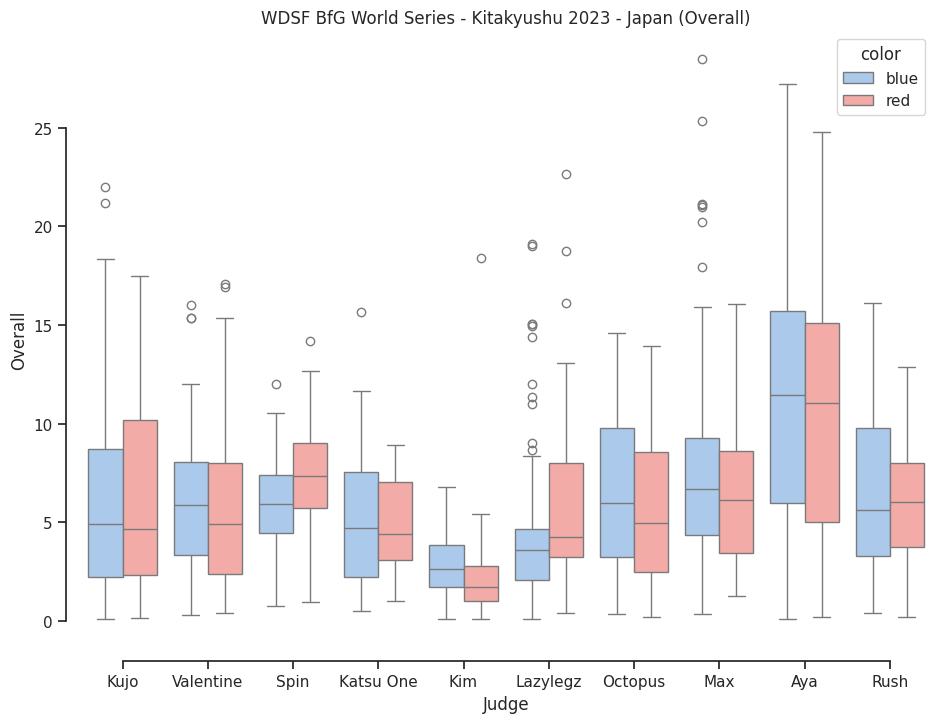

In [250]:
sns_boxplot(event0, temp_df0)

# **WDSF European Breaking Championships 2022 - Manchester**

In [251]:
event1 = events_lst[1]

temp_df1 = event_df(events_lst[1], judge_df)
print("The name of event : ", temp_df1['Event'].iloc[0])
print('')

print(tabulate(temp_df1, headers='keys', tablefmt='psql'))


The name of event :  WDSF European Breaking Championships 2022 - Manchester

+------+---------------------+--------------------------------------------------------+------------------------------------+----------+----------+----------------+------------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|      | Date                | Event                                                  | Category                           | Method   | Gender   | Round_Number   | Judge      | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|------+---------------------+--------------------------------------------------------+------------------------------------+----------+----------+----------------+------------+-------------------+-----------+----------------------+----------------

In [252]:
by_judge_altair(temp_df1)

alt.VConcatChart(...)

In [253]:
by_round_altair(temp_df1)

alt.VConcatChart(...)

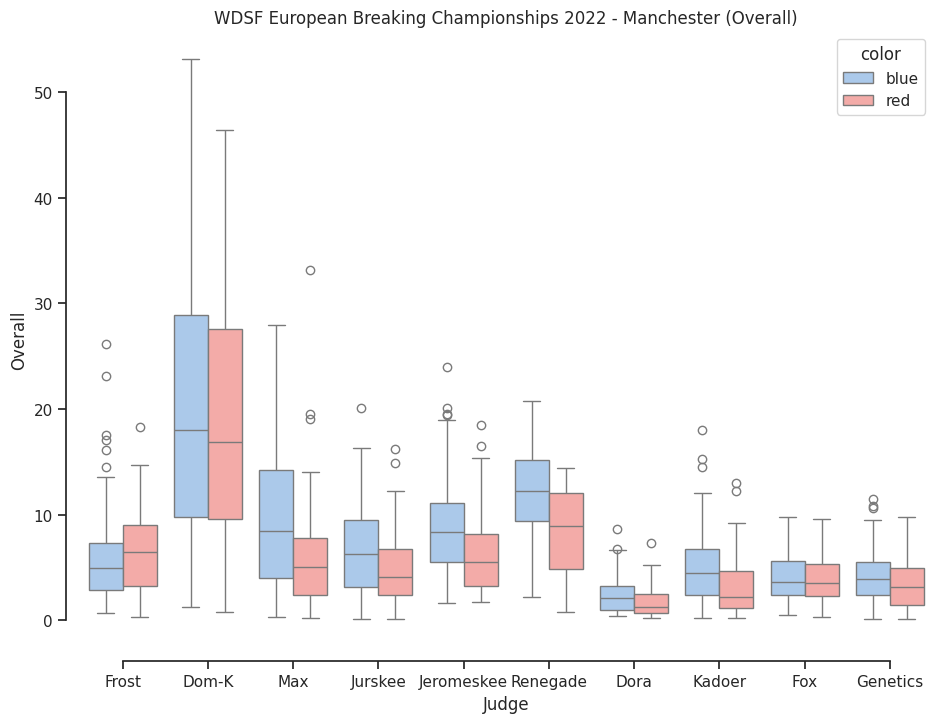

In [254]:
sns_boxplot(event1, temp_df1)

In [255]:
statistics_judges(temp_df1)


Judge :  Frost
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count | 166       |            166       |         166        |                  166       |   166        |    166       |    166        |
| mean  |   6.23277 |              3.12771 |           0.877952 |                    3.67952 |     0.573494 |      1.61928 |      0.974398 |
| std   |   4.37891 |              2.36378 |           1.2773   |                    1.72101 |     1.23008  |      2.03094 |      1.17753  |
| min   |   0.27    |              0       |           0        |                    0       |     0        |      0       |      0       

# WDSF World Championship 2022 - Seoul

In [256]:
event2 = events_lst[2]

temp_df2 = event_df(events_lst[2], judge_df)
print("The name of event : ", temp_df2['Event'].iloc[0])
print('')

print(tabulate(temp_df2, headers='keys', tablefmt='psql'))


The name of event :  WDSF World Championship 2022 - Seoul

+------+---------------------+--------------------------------------+------------------------------------+----------+----------+----------------+-----------+------------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|      | Date                | Event                                | Category                           | Method   | Gender   | Round_Number   | Judge     | Winner_In_Round        |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|------+---------------------+--------------------------------------+------------------------------------+----------+----------+----------------+-----------+------------------------+-----------+----------------------+--------------------+----------------------------+--------------+-----------

In [257]:
by_judge_altair(temp_df2)

alt.VConcatChart(...)

In [258]:
by_round_altair(temp_df2)

alt.VConcatChart(...)

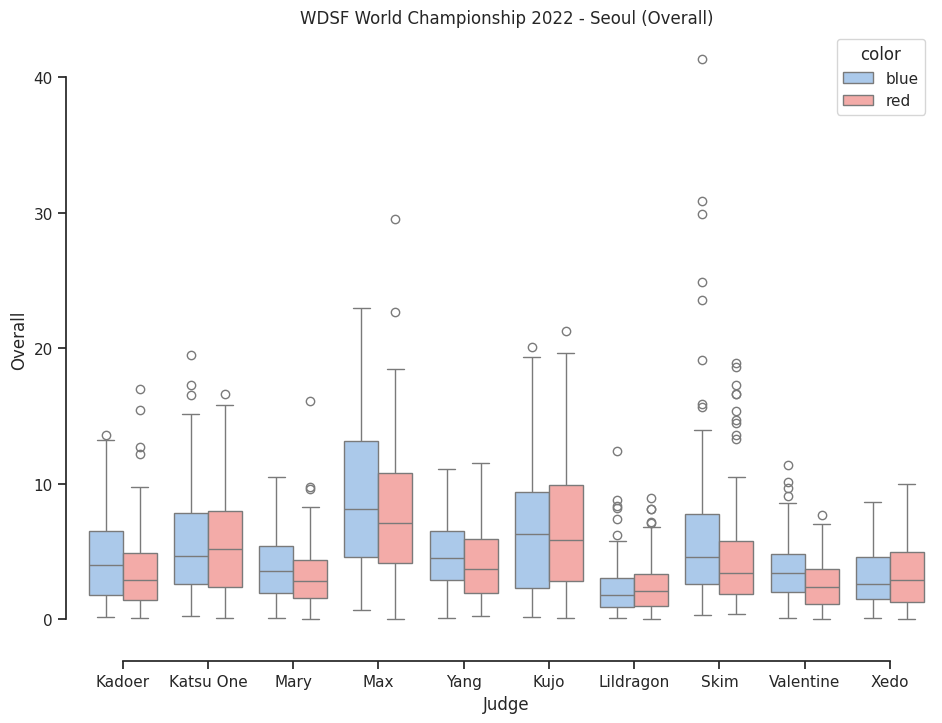

In [259]:
sns_boxplot(event2, temp_df2)

In [260]:
statistics_judges(temp_df2)


Judge :  Kadoer
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count | 230       |            230       |         230        |                  230       |   230        |    230       |    230        |
| mean  |   4.16096 |              2.2687  |           0.713391 |                    1.51565 |     1.07287  |      1.47913 |      0.905304 |
| std   |   3.22647 |              1.31713 |           0.729769 |                    1.12565 |     0.856538 |      1.03906 |      0.702513 |
| min   |   0.07    |              0       |           0        |                    0       |     0        |      0       |      0      

# The IWGA World Games 2022

In [261]:
event3 = events_lst[3]

temp_df3 = event_df(events_lst[3], judge_df)
print("The name of event : ", temp_df3['Event'].iloc[0])
print('')

print(tabulate(temp_df3, headers='keys', tablefmt='psql'))


The name of event :  The IWGA World Games 2022

+------+---------------------+---------------------------+------------------------------------+----------+----------+----------------+-----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|      | Date                | Event                     | Category                           | Method   | Gender   | Round_Number   | Judge     | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|------+---------------------+---------------------------+------------------------------------+----------+----------+----------------+-----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------|
| 5205 | 2022-07-10 00:00:00

In [262]:
by_judge_altair(temp_df3)

alt.VConcatChart(...)

In [263]:
by_round_altair(temp_df3)

alt.VConcatChart(...)

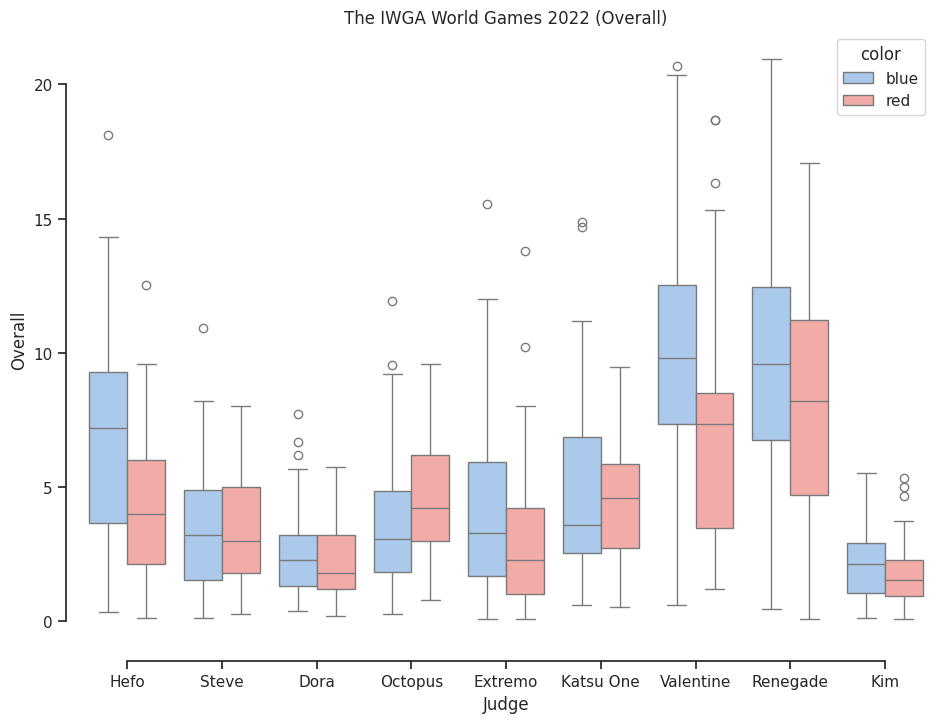

In [264]:
sns_boxplot(event3, temp_df3)

In [265]:
statistics_judges(temp_df3)


Judge :  Hefo
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count | 146       |           146        |         146        |                 146        |   146        |   146        |    146        |
| mean  |   5.6387  |             1.67945  |           0.975685 |                   1.61507  |     0.92411  |     1.54384  |      1.05863  |
| std   |   3.63892 |             0.770662 |           0.429749 |                   0.983473 |     0.675767 |     0.769682 |      0.552315 |
| min   |   0.13    |             0        |           0        |                   0        |     0        |     0        |      0        

# FISE Montpellier 2022 - WDSF Breaking for Gold World Series

In [266]:
event4 = events_lst[4]

temp_df4 = event_df(events_lst[4], judge_df)
print("The name of event : ", temp_df4['Event'].iloc[0])
print('')

print(tabulate(temp_df4, headers='keys', tablefmt='psql'))


The name of event :  FISE Montpellier 2022 - WDSF Breaking for Gold World Series

+------+---------------------+-------------------------------------------------------------+------------------------------------+----------+----------+----------------+-------------+----------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|      | Date                | Event                                                       | Category                           | Method   | Gender   | Round_Number   | Judge       | Winner_In_Round      |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|------+---------------------+-------------------------------------------------------------+------------------------------------+----------+----------+----------------+-------------+----------------------+-----------+-------

In [267]:
by_judge_altair(temp_df4)

alt.VConcatChart(...)

In [268]:
by_round_altair(temp_df4)

alt.VConcatChart(...)

In [269]:
statistics_judges(temp_df4)


Judge :  Hefo
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count | 327       |           327        |         327        |                 327        |   327        |   327        |    327        |
| mean  |   6.42083 |             1.94618  |           1.11275  |                   1.85382  |     1.10859  |     1.75352  |      1.21823  |
| std   |   4.28921 |             0.978688 |           0.654301 |                   0.860469 |     0.666224 |     0.959188 |      0.617673 |
| min   |   0.07    |             0        |           0        |                   0        |     0        |     0        |      0        

# WDSF World Championship 2021 - Paris

In [270]:
event5 = events_lst[5]

temp_df5 = event_df(events_lst[5], judge_df)
print("The name of event : ", temp_df5['Event'].iloc[0])
print('')

print(tabulate(temp_df5, headers='keys', tablefmt='psql'))


The name of event :  WDSF World Championship 2021 - Paris

+-------+---------------------+--------------------------------------+------------------------------------+----------+----------+----------------+-----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|       | Date                | Event                                | Category                           | Method   | Gender   | Round_Number   | Judge     | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|-------+---------------------+--------------------------------------+------------------------------------+----------+----------+----------------+-----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+--------

In [271]:
by_judge_altair(temp_df5)

alt.VConcatChart(...)

In [272]:
by_round_altair(temp_df5)

alt.VConcatChart(...)

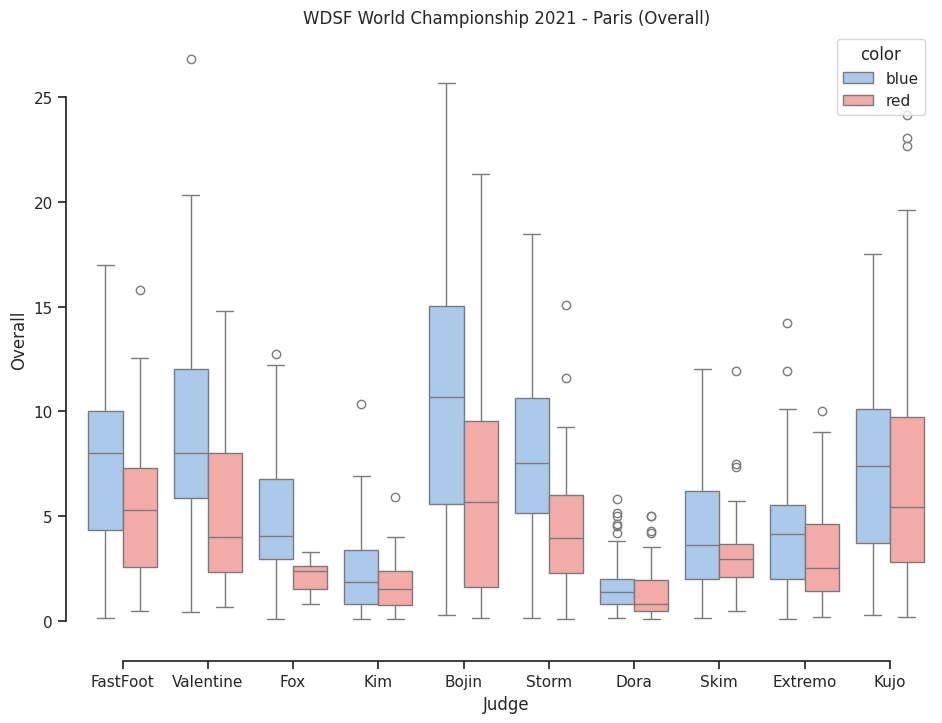

In [273]:
sns_boxplot(event5, temp_df5)

In [274]:
statistics_judges(temp_df5)


Judge :  FastFoot
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count | 137       |            137       |         137        |                  137       |   137        |    137       |    137        |
| mean  |   6.97599 |              2.5854  |           0.92365  |                    2.29343 |     0.734672 |      1.1562  |      0.507299 |
| std   |   3.78832 |              1.31028 |           0.768851 |                    1.66346 |     0.746604 |      1.19919 |      0.721432 |
| min   |   0.13    |              0       |           0        |                    0       |     0        |      0       |      0    

# WDSF European Breaking Championships 2021 - Sochi

In [275]:
event6 = events_lst[6]

temp_df6 = event_df(events_lst[6], judge_df)
print("The name of event : ", temp_df6['Event'].iloc[0])
print('')

print(tabulate(temp_df6, headers='keys', tablefmt='psql'))


The name of event :  WDSF European Breaking Championships 2021 - Sochi

+-------+---------------------+---------------------------------------------------+-------------------------+----------+----------+----------------+-----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|       | Date                | Event                                             | Category                | Method   | Gender   | Round_Number   | Judge     | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|-------+---------------------+---------------------------------------------------+-------------------------+----------+----------+----------------+-----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+----

In [276]:
by_judge_altair(temp_df6)

alt.VConcatChart(...)

In [277]:
by_round_altair(temp_df6)

alt.VConcatChart(...)

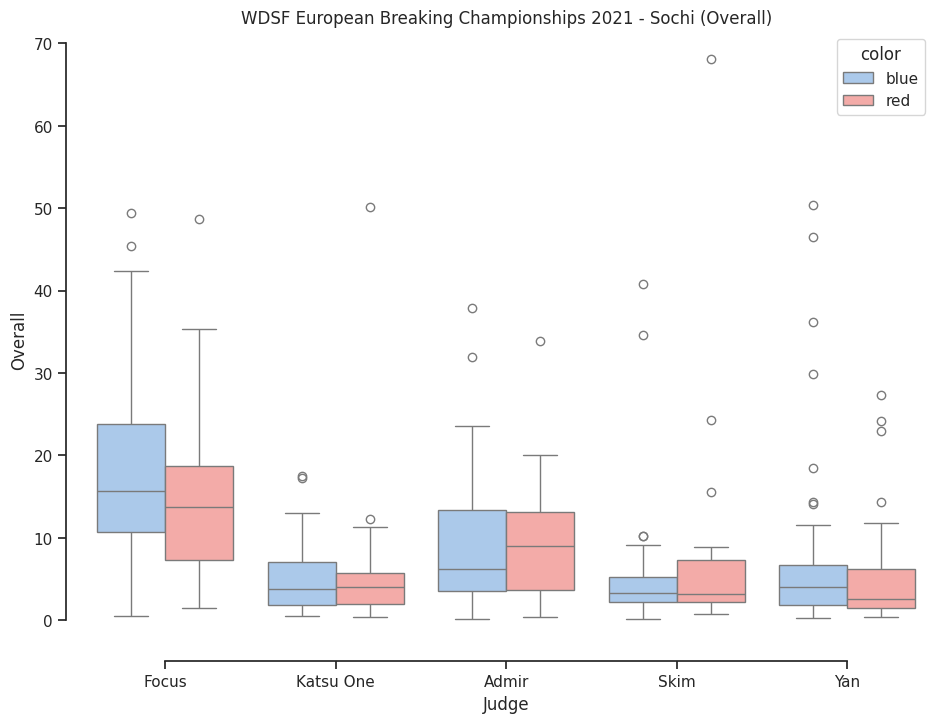

In [278]:
sns_boxplot(event6, temp_df6)

In [279]:
statistics_judges(temp_df6)


Judge :  Focus
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count |   77      |             77       |          77        |                   77       |    77        |     77       |      77       |
| mean  |   16.9368 |              4.89091 |           0.737662 |                    7.80519 |     0.725325 |      2.58701 |       2.17506 |
| std   |   10.6343 |              3.50211 |           0.923208 |                    4.63408 |     0.991415 |      2.14975 |       1.47348 |
| min   |    0.53   |              0       |           0        |                    0       |     0        |      0       |       0      

# World Urban Games 2019

In [280]:
event7 = events_lst[7]

temp_df7 = event_df(events_lst[7], judge_df)
print("The name of event : ", temp_df7['Event'].iloc[0])
print('')

print(tabulate(temp_df7, headers='keys', tablefmt='psql'))


The name of event :  World Urban Games 2019

+-------+---------------------+------------------------+------------------------------------+----------+----------+----------------+-----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|       | Date                | Event                  | Category                           | Method   | Gender   | Round_Number   | Judge     | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|-------+---------------------+------------------------+------------------------------------+----------+----------+----------------+-----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------|
| 11280 | 2019-09-14 00:00:00 | World

In [281]:
by_judge_altair(temp_df7)

alt.VConcatChart(...)

In [282]:
by_round_altair(temp_df7)

alt.VConcatChart(...)

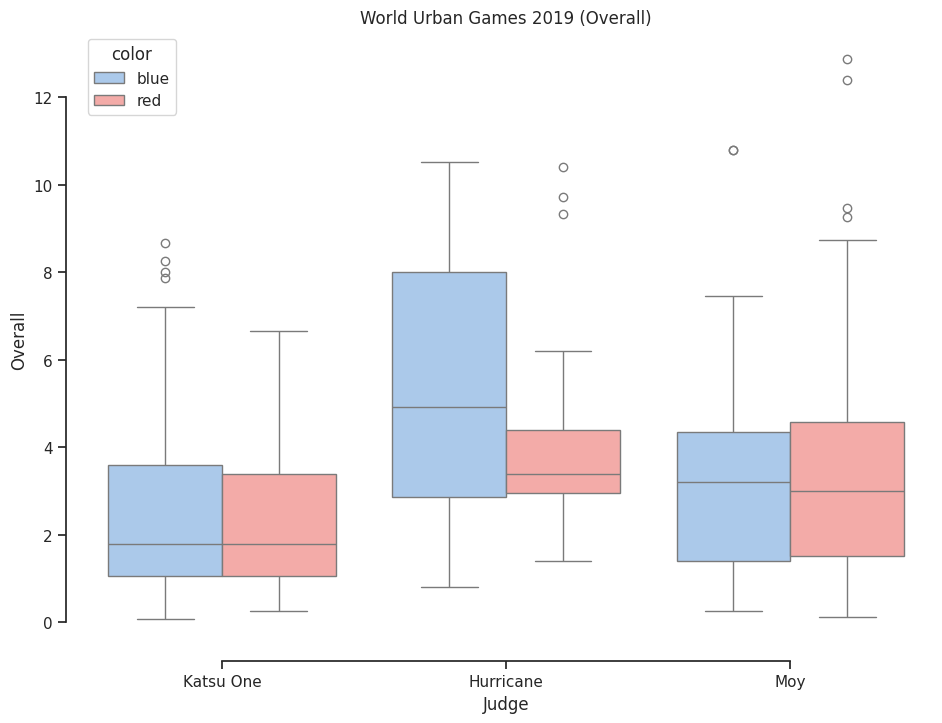

In [283]:
sns_boxplot(event7, temp_df7)

In [284]:
statistics_judges(temp_df7)


Judge :  Katsu One
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count | 148       |           148        |         148        |                  148       |   148        |   148        |    148        |
| mean  |   2.48176 |             0.986486 |           0.755135 |                    1.24189 |     0.406419 |     0.837838 |      0.808851 |
| std   |   1.95837 |             1.06104  |           0.6155   |                    1.06656 |     0.615067 |     1.06812  |      0.670487 |
| min   |   0.07    |             0        |           0        |                    0       |     0        |     0        |      0   

# 2019 JDSF

In [285]:
event8 = events_lst[8]

temp_df8 = event_df(events_lst[8], judge_df)
print("The name of event : ", temp_df8['Event'].iloc[0])
print('')

print(tabulate(temp_df8, headers='keys', tablefmt='psql'))


The name of event :  2019 JDSF

+-------+---------------------+-----------+------------------------+----------+----------+----------------+---------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|       | Date                | Event     | Category               | Method   | Gender   | Round_Number   | Judge   | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|-------+---------------------+-----------+------------------------+----------+----------+----------------+---------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------|
| 11724 | 2019-04-24 00:00:00 | 2019 JDSF | B-Girls Top 8 Knockout | trivium  | Female   | r1             | Tono    | Ayane        

In [286]:
by_judge_altair(temp_df8)

alt.VConcatChart(...)

In [287]:
by_round_altair(temp_df8)

alt.VConcatChart(...)

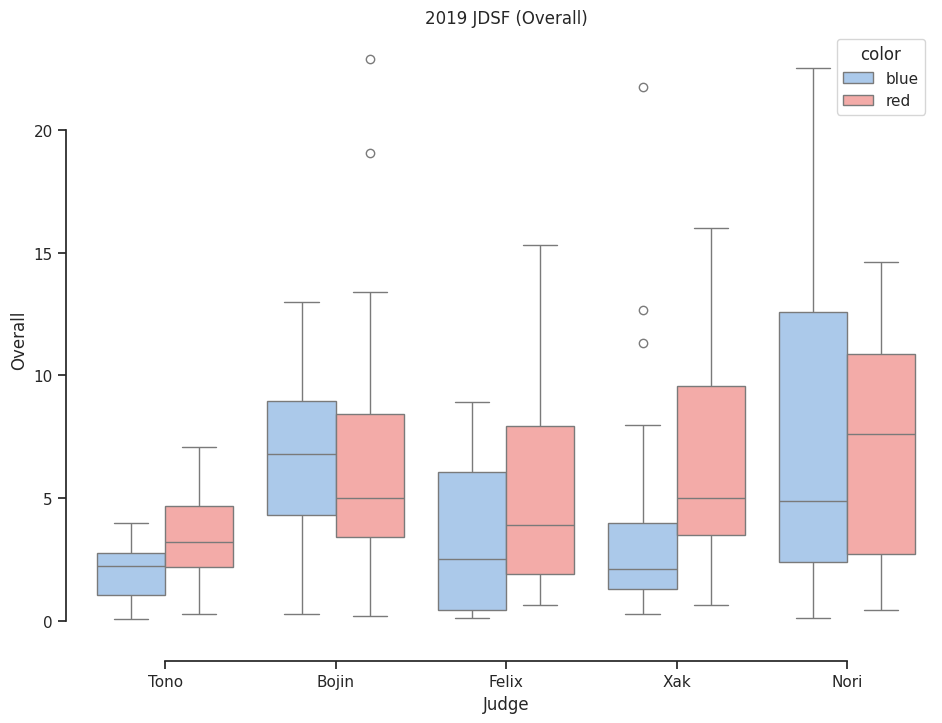

In [288]:
sns_boxplot(event8, temp_df8)

In [289]:
statistics_judges(temp_df8)


Judge :  Tono
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count |  58       |            58        |          58        |                  58        |    58        |    58        |    58         |
| mean  |   2.95724 |             1.23448  |           0.85069  |                   1.06552  |     0.56569  |     0.262069 |     0.0596552 |
| std   |   1.55108 |             0.966192 |           0.554237 |                   0.942105 |     0.567707 |     0.648027 |     0.227465  |
| min   |   0.07    |             0        |           0        |                   0        |     0        |     0        |     0         

# WDSF World Breaking Championship 2019 - Nanjing

In [290]:
event9 = events_lst[9]

temp_df9 = event_df(events_lst[9], judge_df)
print("The name of event : ", temp_df9['Event'].iloc[0])
print('')

print(tabulate(temp_df9, headers='keys', tablefmt='psql'))


The name of event :  WDSF World Breaking Championship 2019 - Nanjing

+-------+---------------------+-------------------------------------------------+------------------------------------+----------+----------+----------------+-----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|       | Date                | Event                                           | Category                           | Method   | Gender   | Round_Number   | Judge     | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|-------+---------------------+-------------------------------------------------+------------------------------------+----------+----------+----------------+-----------+-------------------+-----------+----------------------+--------------------+-----------------------

In [291]:
by_judge_altair(temp_df9)

alt.VConcatChart(...)

In [292]:
by_round_altair(temp_df9)

alt.VConcatChart(...)

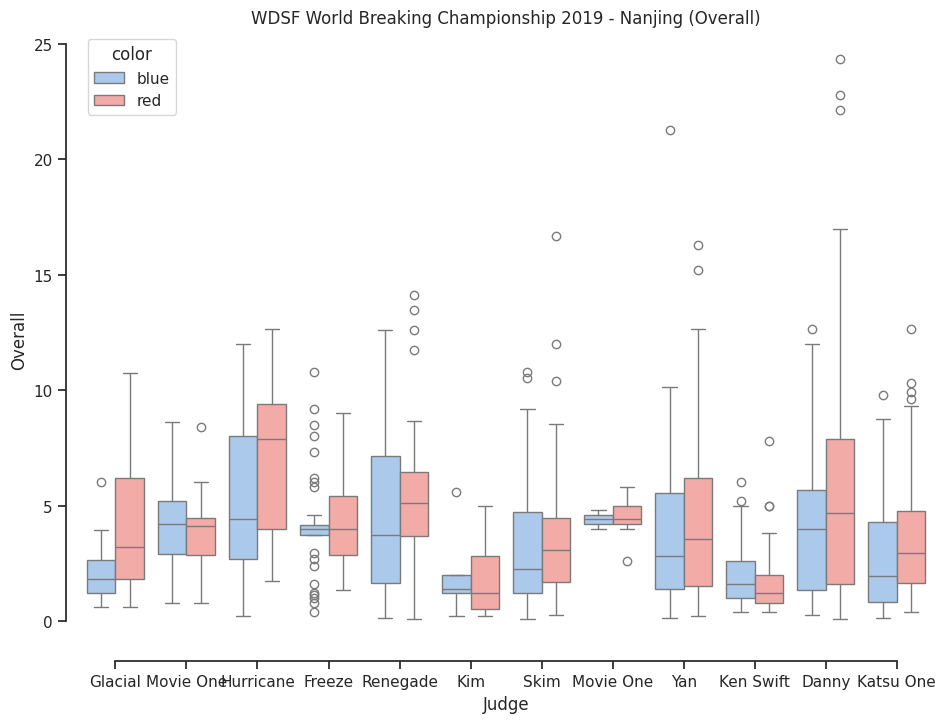

In [293]:
sns_boxplot(event9, temp_df9)

In [294]:
statistics_judges(temp_df9)


Judge :  Glacial
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count |  64       |             64       |          64        |                  64        |    64        |    64        |    64         |
| mean  |   3.37812 |              2.2     |           0.479375 |                   0.790625 |     0.166719 |     0.35     |     0.0832813 |
| std   |   2.54955 |              1.52939 |           0.70907  |                   0.948469 |     0.340243 |     0.677062 |     0.302388  |
| min   |   0.6     |              0       |           0        |                   0        |     0        |     0        |     0      

# FISE Hiroshima 2019

In [295]:
event10 = events_lst[10]

temp_df10 = event_df(events_lst[10], judge_df)
print("The name of event : ", temp_df10['Event'].iloc[0])
print('')

print(tabulate(temp_df10, headers='keys', tablefmt='psql'))


The name of event :  FISE Hiroshima 2019

+-------+---------------------+---------------------+------------------------+----------+----------+----------------+------------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|       | Date                | Event               | Category               | Method   | Gender   | Round_Number   | Judge      | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|-------+---------------------+---------------------+------------------------+----------+----------+----------------+------------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------|
| 13028 | 2019-04-20 00:00:00 | FISE Hiroshima 2019 | B-Girls Top 8 Knockout | tri

In [296]:
by_judge_altair(temp_df10)

alt.VConcatChart(...)

In [297]:
by_judge_altair(temp_df10)

alt.VConcatChart(...)

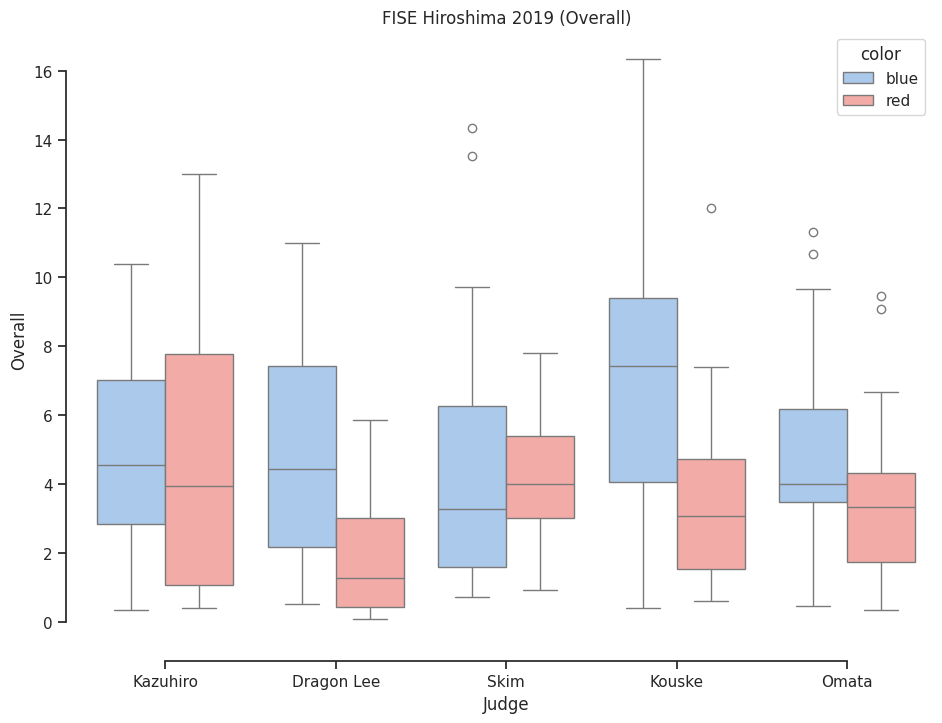

In [298]:
sns_boxplot(event10, temp_df10)

In [299]:
statistics_judges(temp_df10)


Judge :  Kazuhiro
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count |  50       |             50       |          50        |                     50     |    50        |     50       |     50        |
| mean  |   4.8756  |              2.072   |           0.3652   |                      2.572 |     0.6724   |      1.376   |      0.8578   |
| std   |   3.41108 |              1.29537 |           0.609822 |                      1.825 |     0.783924 |      1.25105 |      0.865781 |
| min   |   0.33    |              0       |           0        |                      0     |     0        |      0       |      0    

# BAYOG 2018

In [300]:
event11 = events_lst[11]
temp_df11 = event_df(events_lst[11], judge_df)
print("The name of event : ", temp_df11['Event'].iloc[0])
print('')

print(tabulate(temp_df11, headers='keys', tablefmt='psql'))


The name of event :  BAYOG 2018

+-------+---------------------+------------+----------------------------+----------+----------+----------------+------------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|       | Date                | Event      | Category                   | Method   | Gender   | Round_Number   | Judge      | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|-------+---------------------+------------+----------------------------+----------+----------+----------------+------------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------|
| 13278 | 2018-10-11 00:00:00 | BAYOG 2018 | B-Girls Top 12 Round Robin | trivium  | Female   | r1        

In [301]:
by_judge_altair(temp_df11)

alt.VConcatChart(...)

In [302]:
by_round_altair(temp_df11)

alt.VConcatChart(...)

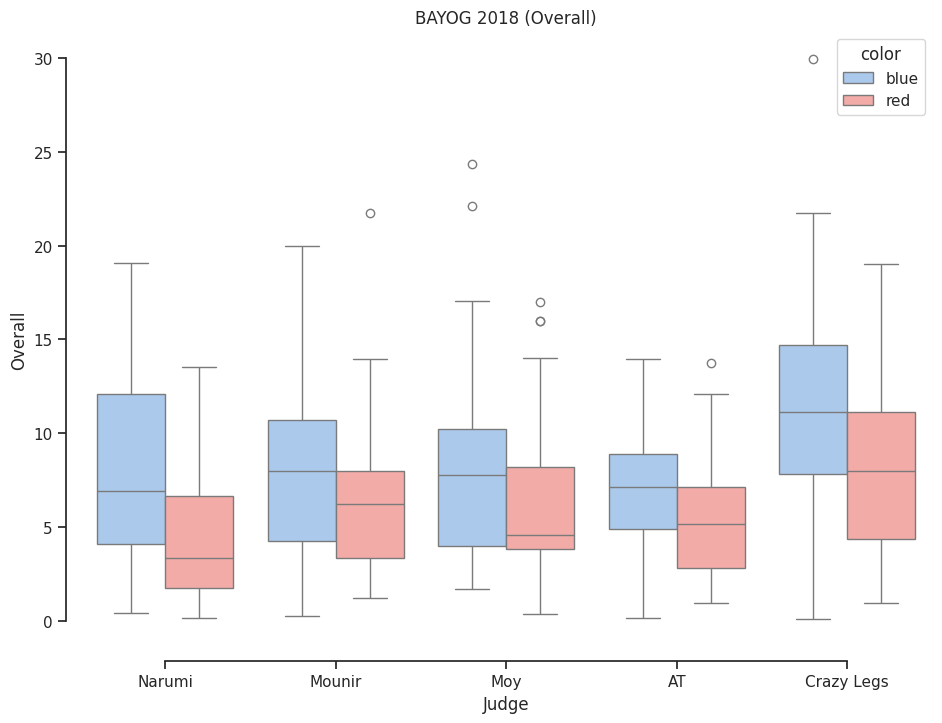

In [303]:
sns_boxplot(event11, temp_df11)

In [304]:
statistics_judges(temp_df11)


Judge :  Narumi
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count | 136       |            136       |          136       |                  136       |   136        |    136       |    136        |
| mean  |   6.71066 |              3.15    |            1.255   |                    1.07206 |     0.924559 |      1.73382 |      0.734265 |
| std   |   4.82791 |              2.16241 |            1.11022 |                    1.52445 |     1.06063  |      1.88845 |      0.918419 |
| min   |   0.13    |              0       |            0       |                    0       |     0        |      0       |      0      

# World Youth Breaking Championships 2018

In [305]:
event12 = events_lst[12]

temp_df12 = event_df(events_lst[12], judge_df)
print("The name of event : ", temp_df12['Event'].iloc[0])
print('')

print(tabulate(temp_df12, headers='keys', tablefmt='psql'))


The name of event :  World Youth Breaking Championships 2018

+-------+---------------------+-----------------------------------------+------------------------------------+----------+----------+----------------+----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|       | Date                | Event                                   | Category                           | Method   | Gender   | Round_Number   | Judge    | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|-------+---------------------+-----------------------------------------+------------------------------------+----------+----------+----------------+----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------

In [306]:
by_judge_altair(temp_df12)

alt.VConcatChart(...)

In [307]:
by_round_altair(temp_df12)

alt.VConcatChart(...)

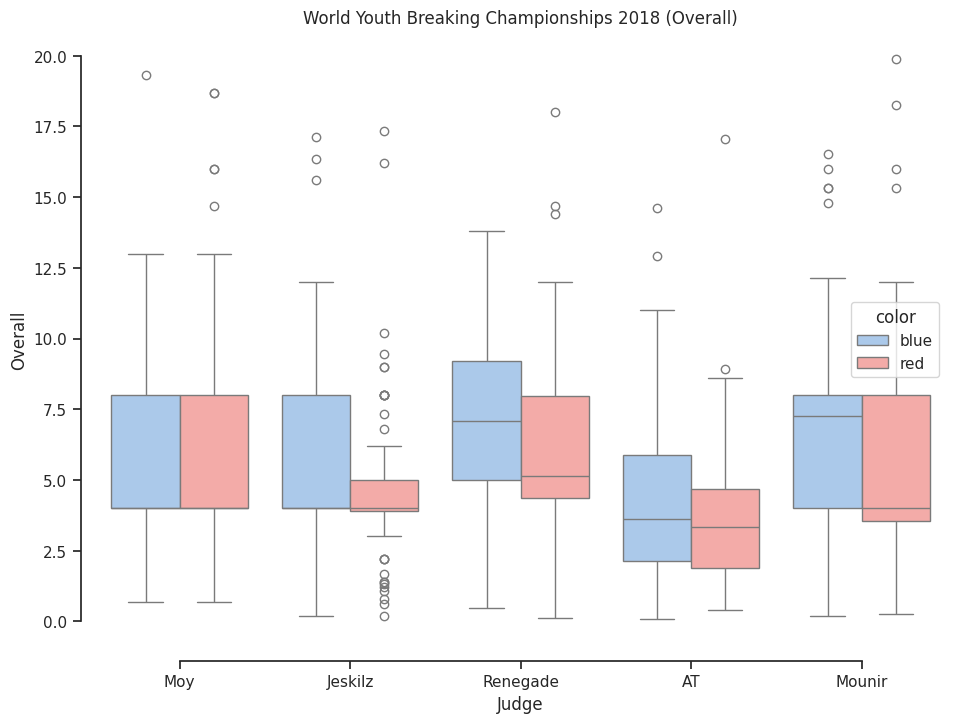

In [308]:
sns_boxplot(event12, temp_df12)

In [309]:
statistics_judges(temp_df12)


Judge :  Moy
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count | 209       |            209       |         209        |                  209       |  209         |    209       |    209        |
| mean  |   5.68244 |              1.84211 |           0.105311 |                    2.74163 |    0.0416746 |      1.11483 |      0.245502 |
| std   |   3.143   |              1.62284 |           0.332452 |                    1.59031 |    0.162207  |      1.13774 |      0.570815 |
| min   |   0.67    |              0       |           0        |                    0       |    0         |      0       |      0        |

# Japan Break Dance Championships 2018

In [310]:
event13 = events_lst[13]
temp_df13 = event_df(events_lst[13], judge_df)
print("The name of event : ", temp_df13['Event'].iloc[0])
print('')

print(tabulate(temp_df13, headers='keys', tablefmt='psql'))


The name of event :  Japan Break Dance Championships 2018

+-------+---------------------+--------------------------------------+----------------+----------+----------+----------------+-----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|       | Date                | Event                                | Category       | Method   | Gender   | Round_Number   | Judge     | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|-------+---------------------+--------------------------------------+----------------+----------+----------+----------------+-----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------|
| 15003 | 2018-04-07 00:00:00 | Japan Bre

In [311]:
by_judge_altair(temp_df13)

alt.VConcatChart(...)

In [312]:
by_round_altair(temp_df13)

alt.VConcatChart(...)

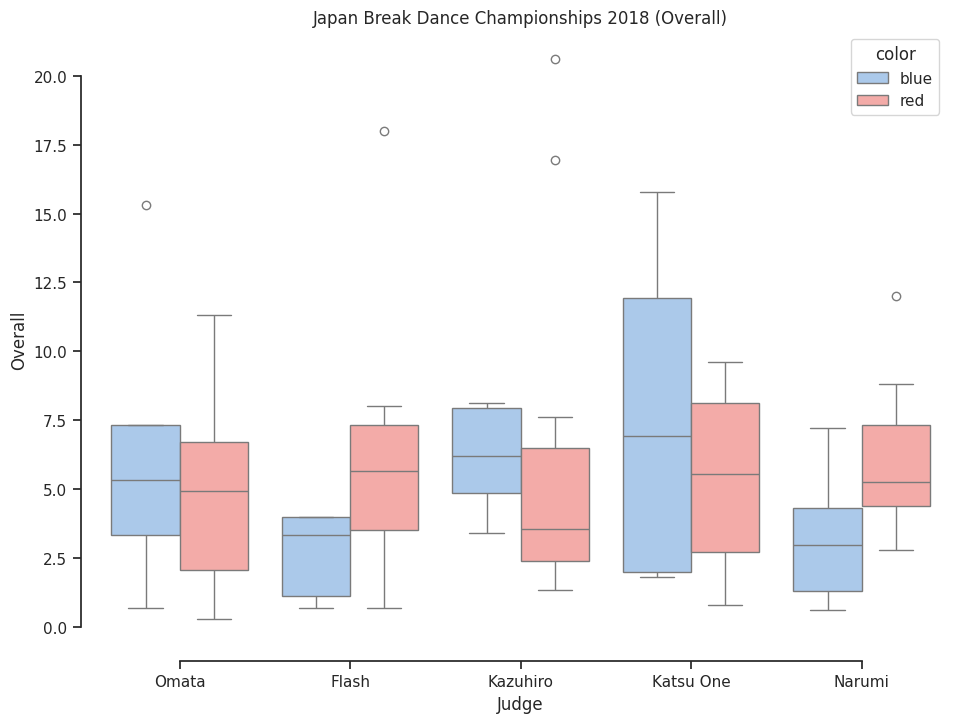

In [313]:
sns_boxplot(event13, temp_df13)

In [314]:
statistics_judges(temp_df13)


Judge :  Omata
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count |  17       |             17       |          17        |                   17       |    17        |    17        |     17        |
| mean  |   5.25412 |              2.52941 |           0.157059 |                    2.52941 |     0.188235 |     0.870588 |      1.05647  |
| std   |   3.97213 |              1.94029 |           0.356314 |                    2.12478 |     0.305905 |     0.989801 |      0.528582 |
| min   |   0.27    |              0       |           0        |                    0       |     0        |     0        |      0       

# YOG Continental Qualifier 2017 Asia & Oceania

In [315]:
event14 = events_lst[14]
temp_df14 = event_df(events_lst[14], judge_df)
print("The name of event : ", temp_df14['Event'].iloc[0])
print('')

print(tabulate(temp_df14, headers='keys', tablefmt='psql'))


The name of event :  YOG Continental Qualifier 2017 Asia & Oceania

+-------+---------------------+-----------------------------------------------+------------------------------------+----------+----------+----------------+-----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|       | Date                | Event                                         | Category                           | Method   | Gender   | Round_Number   | Judge     | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|-------+---------------------+-----------------------------------------------+------------------------------------+----------+----------+----------------+-----------+-------------------+-----------+----------------------+--------------------+----------------------------+--

In [316]:
by_judge_altair(temp_df14)

alt.VConcatChart(...)

In [317]:
by_round_altair(temp_df14)

alt.VConcatChart(...)

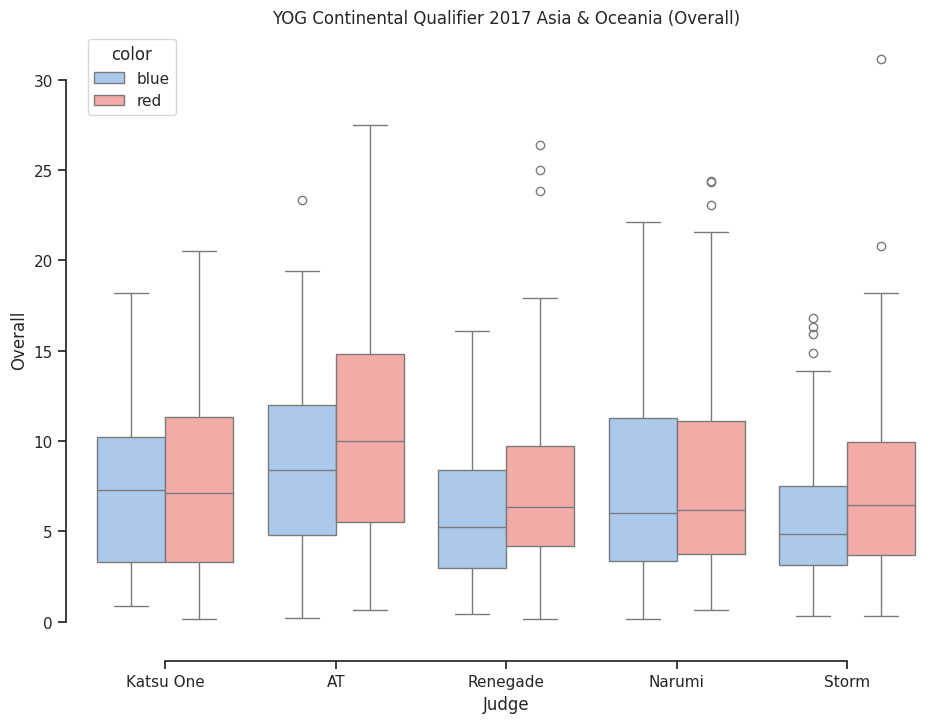

In [318]:
sns_boxplot(event14, temp_df14)

In [319]:
statistics_judges(temp_df14)


Judge :  Katsu One
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count | 176       |            176       |         176        |                  176       |   176        |    176       |    176        |
| mean  |   7.48295 |              2.24886 |           0.650114 |                    3.16932 |     0.73858  |      1.13182 |      1.0767   |
| std   |   4.79935 |              1.48181 |           0.681212 |                    2.22736 |     0.869712 |      1.08807 |      0.841566 |
| min   |   0.13    |              0       |           0        |                    0       |     0        |      0       |      0   

# YOG Continental Qualifier 2017 Europe

In [320]:
event15 = events_lst[15]
temp_df15 = event_df(events_lst[15], judge_df)
print("The name of event : ", temp_df15['Event'].iloc[0])
print('')

print(tabulate(temp_df15, headers='keys', tablefmt='psql'))


The name of event :  YOG Continental Qualifier 2017 Europe

+-------+---------------------+---------------------------------------+------------------------------------+----------+----------+----------------+------------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|       | Date                | Event                                 | Category                           | Method   | Gender   | Round_Number   | Judge      | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|-------+---------------------+---------------------------------------+------------------------------------+----------+----------+----------------+------------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+-

In [321]:
by_judge_altair(temp_df15)

alt.VConcatChart(...)

In [322]:
by_round_altair(temp_df15)

alt.VConcatChart(...)

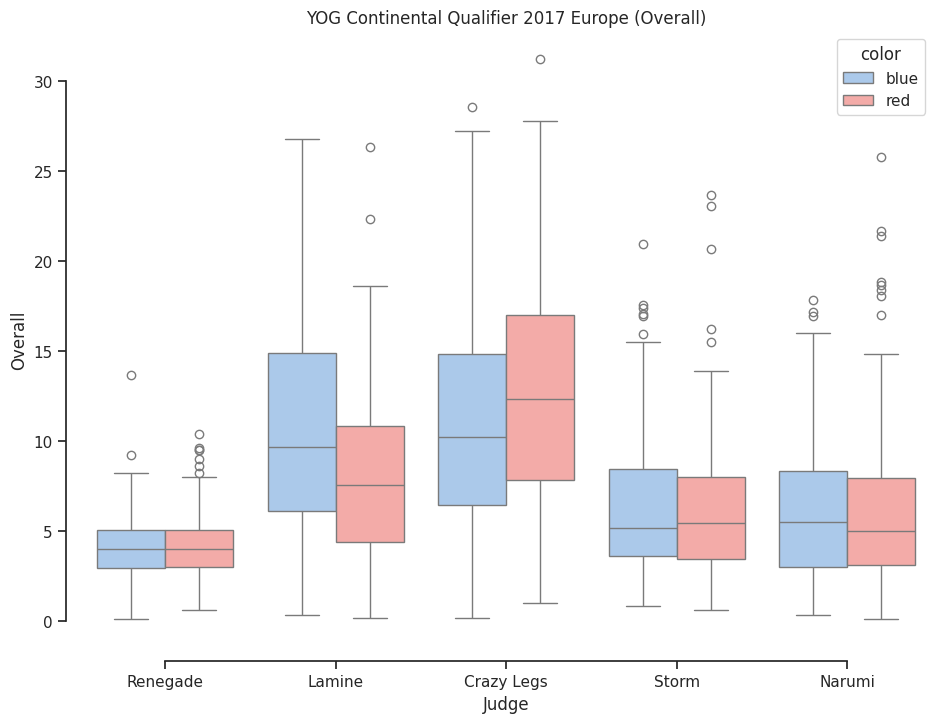

In [323]:
sns_boxplot(event15, temp_df15)

In [324]:
statistics_judges(temp_df15)


Judge :  Renegade
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count | 176       |            176       |         176        |                  176       |    176       |    176       |    176        |
| mean  |   4.25159 |              2.69318 |           0.106193 |                    1.14773 |      0.14625 |      0.6     |      0.447102 |
| std   |   2.2067  |              1.83713 |           0.403831 |                    1.37005 |      0.45004 |      1.25512 |      0.837169 |
| min   |   0.07    |              0       |           0        |                    0       |      0       |      0       |      0    

# 2017 BreakSM

In [325]:
event16 = events_lst[16]
temp_df16 = event_df(events_lst[16], judge_df)
print("The name of event : ", temp_df16['Event'].iloc[0])
print('')

print(tabulate(temp_df16, headers='keys', tablefmt='psql'))


The name of event :  2017 BreakSM

+-------+---------------------+--------------+-------------------------------+----------+----------+----------------+---------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|       | Date                | Event        | Category                      | Method   | Gender   | Round_Number   | Judge   | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|-------+---------------------+--------------+-------------------------------+----------+----------+----------------+---------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------|
| 16848 | 2017-10-14 00:00:00 | 2017 BreakSM | B-Boys Juniors Top 4 Knockout | trivium  | Male    

In [326]:
by_judge_altair(temp_df16)

alt.VConcatChart(...)

In [327]:
by_round_altair(temp_df16)

alt.VConcatChart(...)

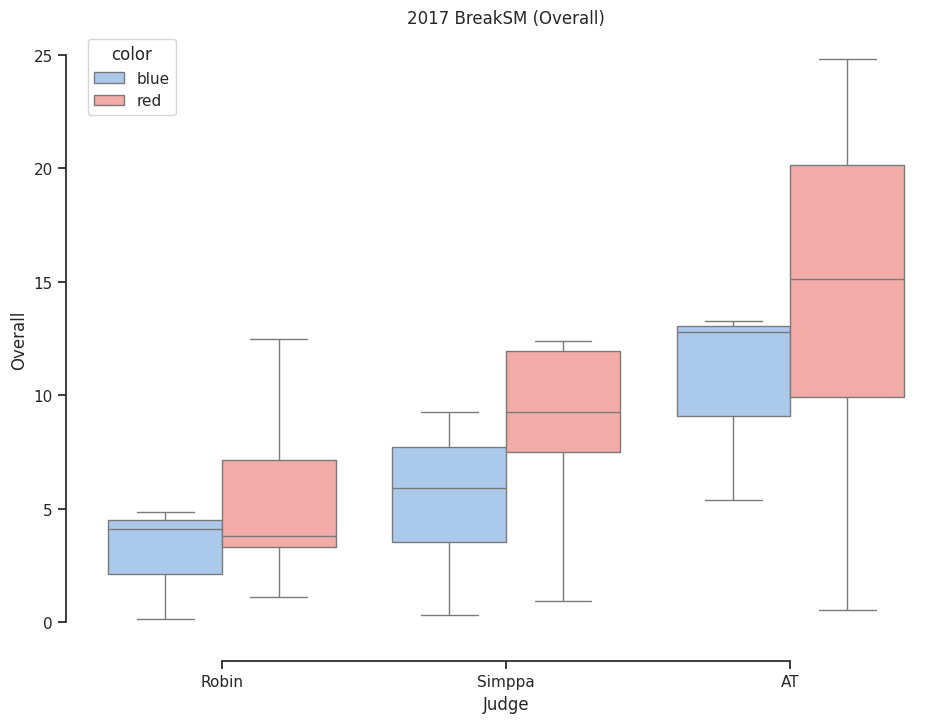

In [328]:
sns_boxplot(event16, temp_df16)

In [329]:
statistics_judges(temp_df16)


Judge :  Robin
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count |  12       |             12       |          12        |                   12       |    12        |    12        |     12        |
| mean  |   4.69333 |              2.03333 |           0.978333 |                    1.7     |     0.755833 |     1.85     |      1.1225   |
| std   |   3.60387 |              1.00484 |           0.711961 |                    1.04968 |     0.448907 |     0.831756 |      0.657144 |
| min   |   0.13    |              0.2     |           0        |                    0       |     0        |     0.8      |      0       

# YOG Continental Qualifier 2017 USA

In [330]:
event17 = events_lst[17]
temp_df17 = event_df(events_lst[17], judge_df)
print("The name of event : ", temp_df17['Event'].iloc[0])
print('')

print(tabulate(temp_df17, headers='keys', tablefmt='psql'))


The name of event :  YOG Continental Qualifier 2017 USA

+-------+---------------------+------------------------------------+-----------------------------------+----------+----------+----------------+----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|       | Date                | Event                              | Category                          | Method   | Gender   | Round_Number   | Judge    | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|-------+---------------------+------------------------------------+-----------------------------------+----------+----------+----------------+----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+------

In [331]:
by_judge_altair(temp_df17)

alt.VConcatChart(...)

In [332]:
by_round_altair(temp_df17)

alt.VConcatChart(...)

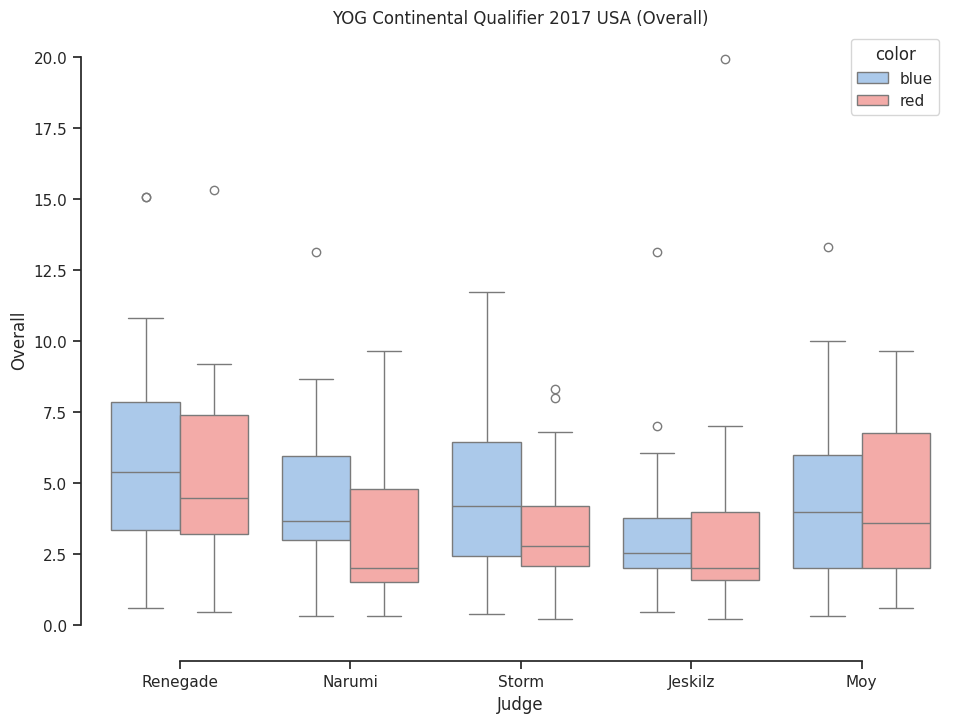

In [333]:
sns_boxplot(event17, temp_df17)

In [334]:
statistics_judges(temp_df17)


Judge :  Renegade
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count |  76       |             76       |          76        |                   76       |    76        |    76        |      76       |
| mean  |   5.69461 |              2.60263 |           0.387895 |                    1.84211 |     0.575395 |     0.944737 |       1.25803 |
| std   |   3.31187 |              2.0303  |           0.877252 |                    1.81764 |     1.03461  |     1.52371  |       1.37976 |
| min   |   0.47    |              0       |           0        |                    0       |     0        |     0        |       0   

# BOTY Central Europe 2017

In [335]:
event18 = events_lst[18]
temp_df18 = event_df(events_lst[18], judge_df)
print("The name of event : ", temp_df18['Event'].iloc[0])
print('')

print(tabulate(temp_df18, headers='keys', tablefmt='psql'))


The name of event :  BOTY Central Europe 2017

+-------+---------------------+--------------------------+----------------+----------+----------+----------------+----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|       | Date                | Event                    | Category       | Method   | Gender   | Round_Number   | Judge    | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|-------+---------------------+--------------------------+----------------+----------+----------+----------------+----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------|
| 17264 | 2017-09-23 00:00:00 | BOTY Central Europe 2017 | Top 4 Knockout | trivium  | Male 

In [336]:
by_judge_altair(temp_df18)

alt.VConcatChart(...)

In [337]:
by_round_altair(temp_df18)

alt.VConcatChart(...)

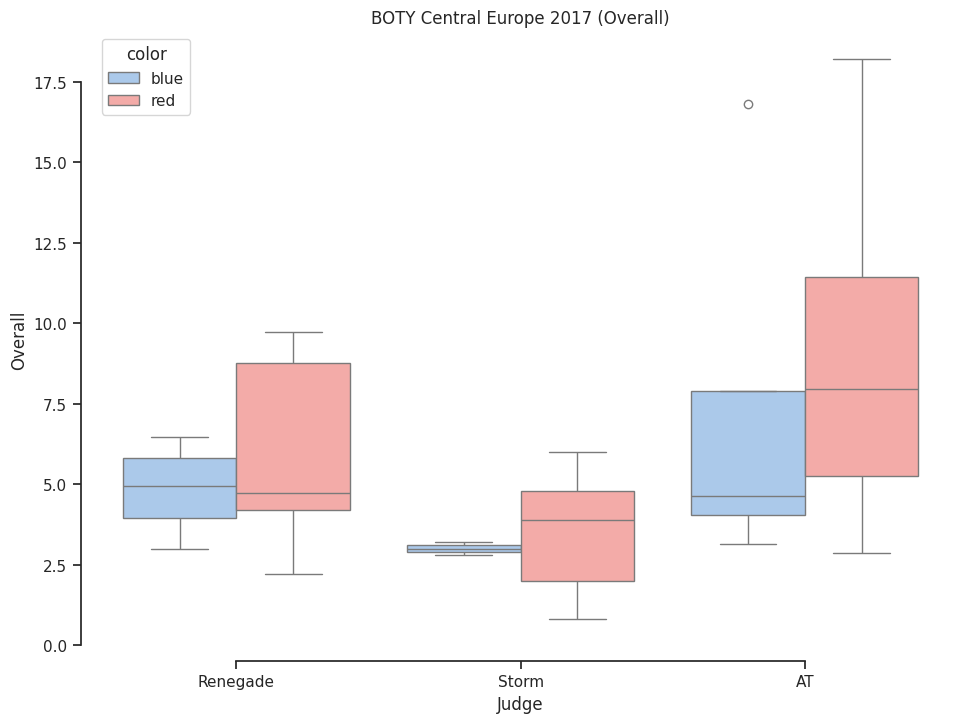

In [338]:
sns_boxplot(event18, temp_df18)

In [339]:
statistics_judges(temp_df18)


Judge :  Renegade
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count |  12       |            12        |          12        |                   12       |      12      |     12       |      12       |
| mean  |   5.56083 |             3.78333  |           0.344167 |                    1.41667 |       1.31   |      1.31667 |       1.3     |
| std   |   2.50954 |             0.992548 |           0.884384 |                    1.61461 |       1.1421 |      1.6959  |       1.48463 |
| min   |   2.2     |             2.8      |           0        |                    0       |       0      |      0       |       0   

# WDSF Pan American Qualifier 2017 - Philadelphia

In [340]:
event19 = events_lst[19]
temp_df19 = event_df(events_lst[19], judge_df)
print("The name of event : ", temp_df19['Event'].iloc[0])
print('')

print(tabulate(temp_df19, headers='keys', tablefmt='psql'))


The name of event :  WDSF Pan American Qualifier 2017 - Philadelphia

+-------+---------------------+-------------------------------------------------+-----------------------------------+----------+----------+----------------+----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|       | Date                | Event                                           | Category                          | Method   | Gender   | Round_Number   | Judge    | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|-------+---------------------+-------------------------------------------------+-----------------------------------+----------+----------+----------------+----------+-------------------+-----------+----------------------+--------------------+----------------------------+

In [341]:
by_judge_altair(temp_df19)

alt.VConcatChart(...)

In [342]:
by_round_altair(temp_df19)

alt.VConcatChart(...)

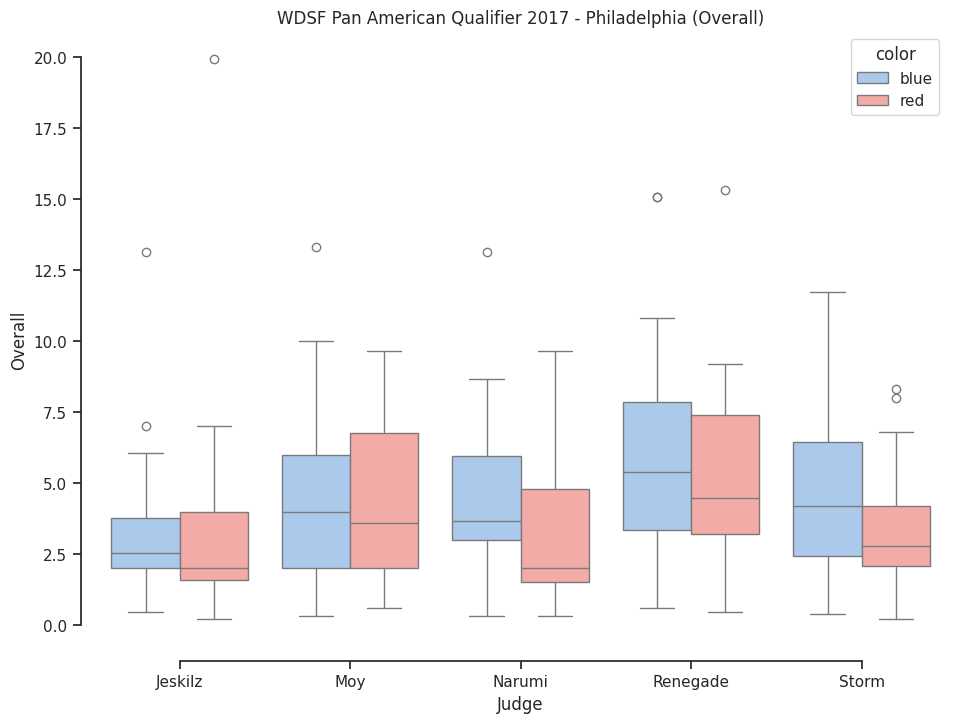

In [343]:
sns_boxplot(event19, temp_df19)

In [344]:
statistics_judges(temp_df19)


Judge :  Jeskilz
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count |  76       |            76        |          76        |                  76        |    76        |    76        |      76       |
| mean  |   3.04487 |             1.10526  |           0.250921 |                   1.17632  |     0.517632 |     0.426316 |       0.395   |
| std   |   2.7876  |             0.816806 |           0.55842  |                   0.683495 |     1.56265  |     0.520863 |       1.53118 |
| min   |   0.2     |             0        |           0        |                   0        |     0        |     0        |       0    

# Campionato Italiano di Categoria Breaking FIDS 2023

In [345]:
event20 = events_lst[20]
temp_df20 = event_df(events_lst[20], judge_df)
print("The name of event : ", temp_df20['Event'].iloc[0])
print('')

print(tabulate(temp_df20, headers='keys', tablefmt='psql'))


The name of event :  Campionato Italiano di Categoria Breaking FIDS 2023

+-------+---------------------+-----------------------------------------------------+-----------------------------------+----------+----------+----------------+----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|       | Date                | Event                                               | Category                          | Method   | Gender   | Round_Number   | Judge    | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|-------+---------------------+-----------------------------------------------------+-----------------------------------+----------+----------+----------------+----------+-------------------+-----------+----------------------+--------------------+-------------

In [346]:
by_judge_altair(temp_df20)

alt.VConcatChart(...)

In [347]:
by_round_altair(temp_df20)

alt.VConcatChart(...)

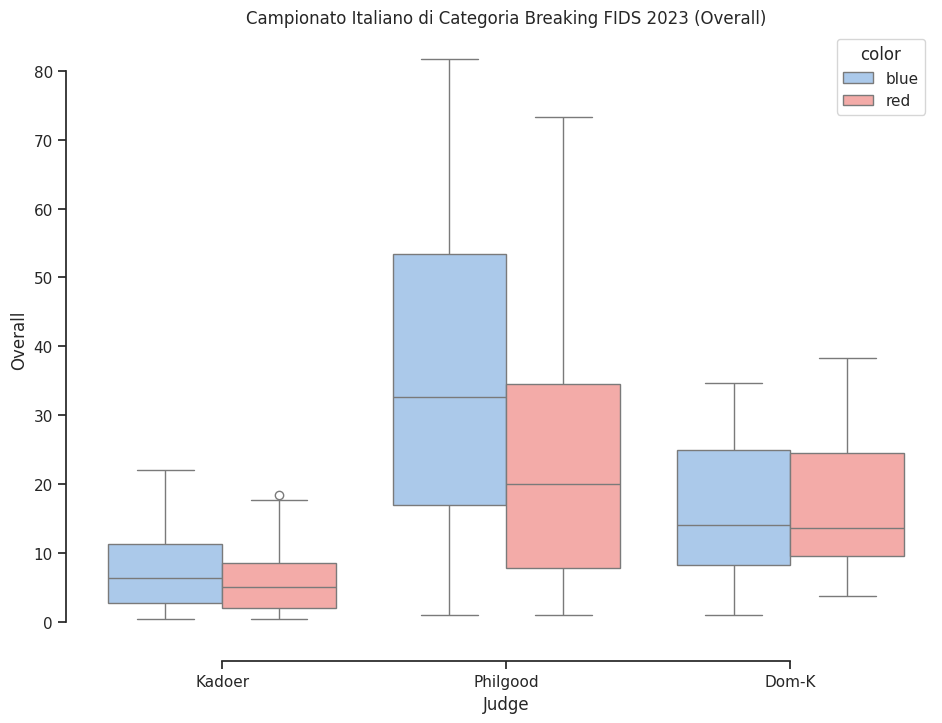

In [348]:
sns_boxplot(event20, temp_df20)

In [349]:
statistics_judges(temp_df20)


Judge :  Kadoer
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count | 153       |            153       |          153       |                  153       |            0 |            0 |             0 |
| mean  |   7.22895 |              4.37235 |            3.52712 |                    3.53758 |          nan |          nan |           nan |
| std   |   5.45164 |              2.05499 |            1.73359 |                    1.83275 |          nan |          nan |           nan |
| min   |   0.33    |              0       |            0       |                    0       |          nan |          nan |           na

# German Breaking Championship 2023

In [350]:
event21 = events_lst[21]
temp_df21 = event_df(events_lst[21], judge_df)
print("The name of event : ", temp_df21['Event'].iloc[0])
print('')

print(tabulate(temp_df21, headers='keys', tablefmt='psql'))


The name of event :  German Breaking Championship 2023

+-------+---------------------+-----------------------------------+----------------------------------------+----------+----------+----------------+---------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|       | Date                | Event                             | Category                               | Method   | Gender   | Round_Number   | Judge   | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|-------+---------------------+-----------------------------------+----------------------------------------+----------+----------+----------------+---------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+--------------

In [351]:
by_judge_altair(temp_df21)

alt.VConcatChart(...)

In [352]:
by_round_altair(temp_df21)

alt.VConcatChart(...)

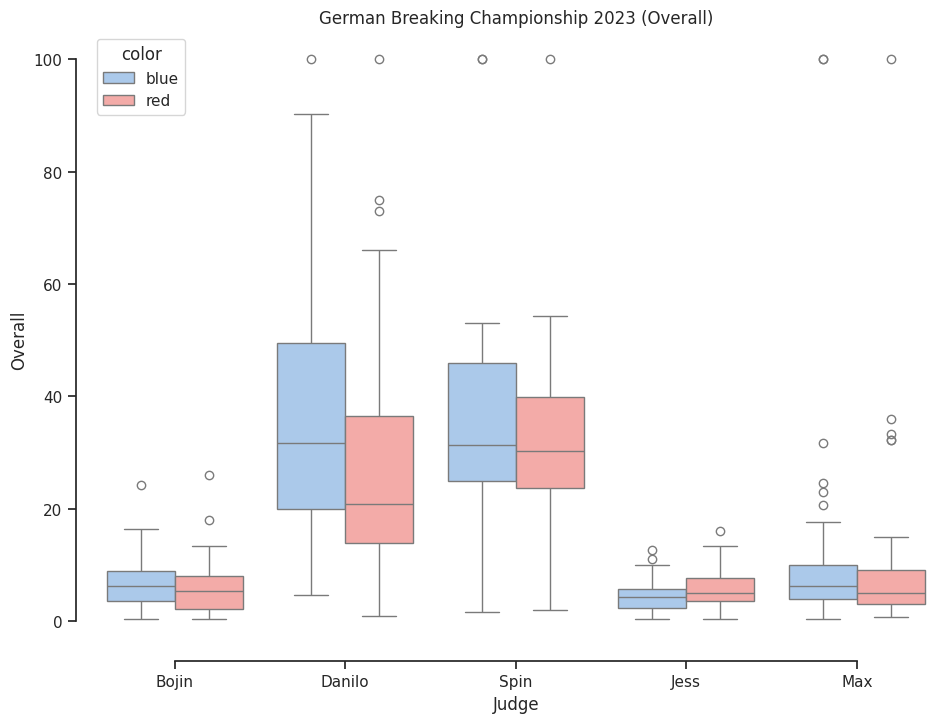

In [353]:
sns_boxplot(event21, temp_df21)

In [354]:
statistics_judges(temp_df21)


Judge :  Bojin
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count | 152       |            152       |          152       |                  152       |            0 |            0 |             0 |
| mean  |   6.29401 |              3.53059 |            2.29158 |                    1.96658 |          nan |          nan |           nan |
| std   |   4.18803 |              2.23635 |            1.55224 |                    1.51376 |          nan |          nan |           nan |
| min   |   0.33    |              0       |            0       |                    0       |          nan |          nan |           nan

# JDSF Breaking Block Battle Series 2023 – Kansai

In [355]:
event22 = events_lst[22]
temp_df22 = event_df(events_lst[22], judge_df)
print("The name of event : ", temp_df22['Event'].iloc[0])
print('')

print(tabulate(temp_df22, headers='keys', tablefmt='psql'))


The name of event :  JDSF Breaking Block Battle Series 2023 – Kansai

+-------+---------------------+-------------------------------------------------+-----------------------------------+----------+----------+----------------+------------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|       | Date                | Event                                           | Category                          | Method   | Gender   | Round_Number   | Judge      | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|-------+---------------------+-------------------------------------------------+-----------------------------------+----------+----------+----------------+------------+-------------------+-----------+----------------------+--------------------+-----------------------

In [356]:
by_judge_altair(temp_df22)

alt.VConcatChart(...)

In [357]:
by_round_altair(temp_df22)

alt.VConcatChart(...)

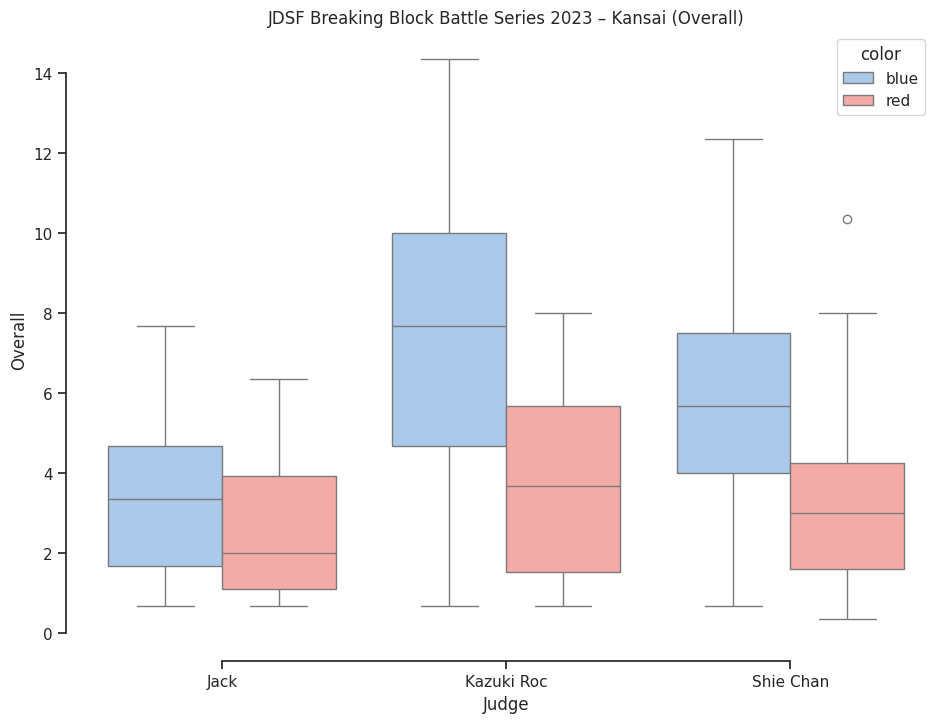

In [358]:
sns_boxplot(event22, temp_df22)

In [359]:
statistics_judges(temp_df22)


Judge :  Jack
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count |  59       |            59        |          59        |                  59        |            0 |            0 |             0 |
| mean  |   3.16339 |             1.8022   |           1.87068  |                   1.92102  |          nan |          nan |           nan |
| std   |   1.92129 |             0.978944 |           0.732214 |                   0.682191 |          nan |          nan |           nan |
| min   |   0.67    |             0        |           0.67     |                   0.33     |          nan |          nan |           nan 

# The Movement ARENA 2023

In [360]:
event23 = events_lst[23]
temp_df23 = event_df(events_lst[23], judge_df)
print("The name of event : ", temp_df23['Event'].iloc[0])
print('')

print(tabulate(temp_df23, headers='keys', tablefmt='psql'))


The name of event :  The Movement ARENA 2023

+-------+---------------------+-------------------------+------------------------------------------------+----------+----------+----------------+-----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|       | Date                | Event                   | Category                                       | Method   | Gender   | Round_Number   | Judge     | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|-------+---------------------+-------------------------+------------------------------------------------+----------+----------+----------------+-----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+--------

In [361]:
by_judge_altair(temp_df23)

alt.VConcatChart(...)

In [362]:
by_round_altair(temp_df22)

alt.VConcatChart(...)

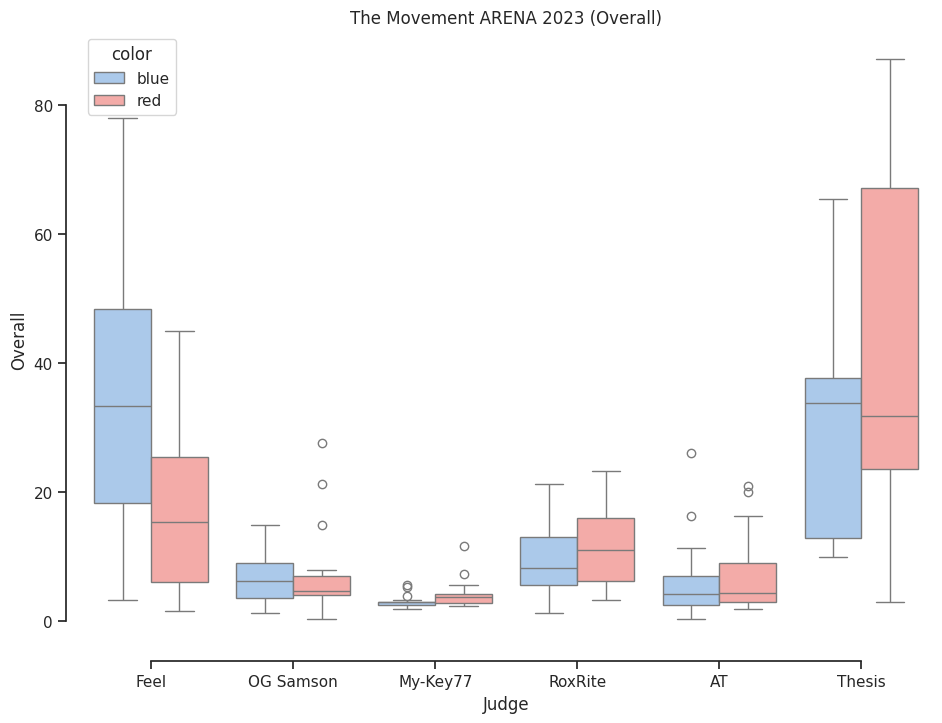

In [363]:
sns_boxplot(event23, temp_df23)

In [364]:
statistics_judges(temp_df23)


Judge :  Feel
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count |   39      |             39       |           39       |                   39       |            0 |            0 |             0 |
| mean  |   27.2223 |             11.6928  |           10.9744  |                   11.41    |          nan |          nan |           nan |
| std   |   20.0805 |              6.83046 |            6.32823 |                    5.93079 |          nan |          nan |           nan |
| min   |    1.67   |              0       |            0       |                    0.67    |          nan |          nan |           nan 

# Hip Hop Grand Slam & DTV Ranking Battle 2023

In [365]:
event24 = events_lst[24]
temp_df24 = event_df(events_lst[24], judge_df)
print("The name of event : ", temp_df24['Event'].iloc[0])
print('')

print(tabulate(temp_df24, headers='keys', tablefmt='psql'))


The name of event :  Hip Hop Grand Slam & DTV Ranking Battle 2023

+-------+---------------------+----------------------------------------------+-----------------------------+----------+----------+----------------+---------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|       | Date                | Event                                        | Category                    | Method   | Gender   | Round_Number   | Judge   | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|-------+---------------------+----------------------------------------------+-----------------------------+----------+----------+----------------+---------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---

In [366]:
by_judge_altair(temp_df24)

alt.VConcatChart(...)

In [367]:
by_round_altair(temp_df24)

alt.VConcatChart(...)

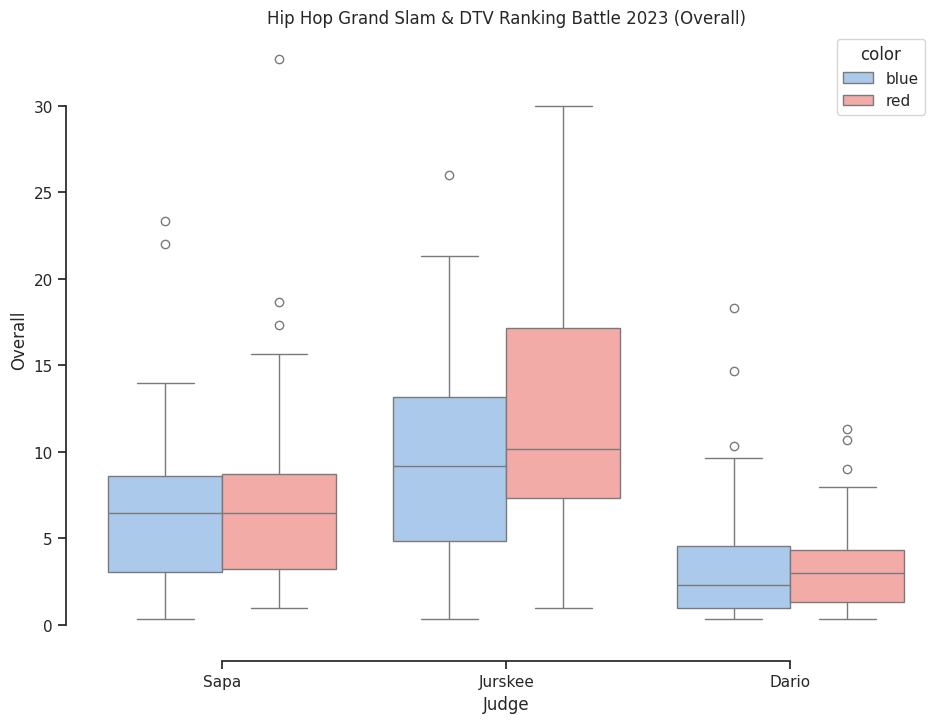

In [368]:
sns_boxplot(event24, temp_df24)

In [369]:
statistics_judges(temp_df24)


Judge :  Sapa
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count |  86       |             86       |           86       |                   86       |            0 |            0 |             0 |
| mean  |   6.87616 |              2.94535 |            2.82547 |                    2.69407 |          nan |          nan |           nan |
| std   |   5.46173 |              1.73983 |            1.52718 |                    1.72319 |          nan |          nan |           nan |
| min   |   0.33    |              0.67    |            0.33    |                    0       |          nan |          nan |           nan 

# UK BBOY CHAMPIONSHIPS / UNDISPUTED LONDON 2023

In [370]:
event25 = events_lst[25]
temp_df25 = event_df(events_lst[25], judge_df)
print("The name of event : ", temp_df25['Event'].iloc[0])
print('')

print(tabulate(temp_df25, headers='keys', tablefmt='psql'))


The name of event :  UK BBOY CHAMPIONSHIPS / UNDISPUTED LONDON 2023

+-------+---------------------+------------------------------------------------+---------------------------+----------+----------+----------------+----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|       | Date                | Event                                          | Category                  | Method   | Gender   | Round_Number   | Judge    | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|-------+---------------------+------------------------------------------------+---------------------------+----------+----------+----------------+----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+-------------

In [371]:
by_judge_altair(temp_df25)

alt.VConcatChart(...)

In [372]:
by_round_altair(temp_df25)

alt.VConcatChart(...)

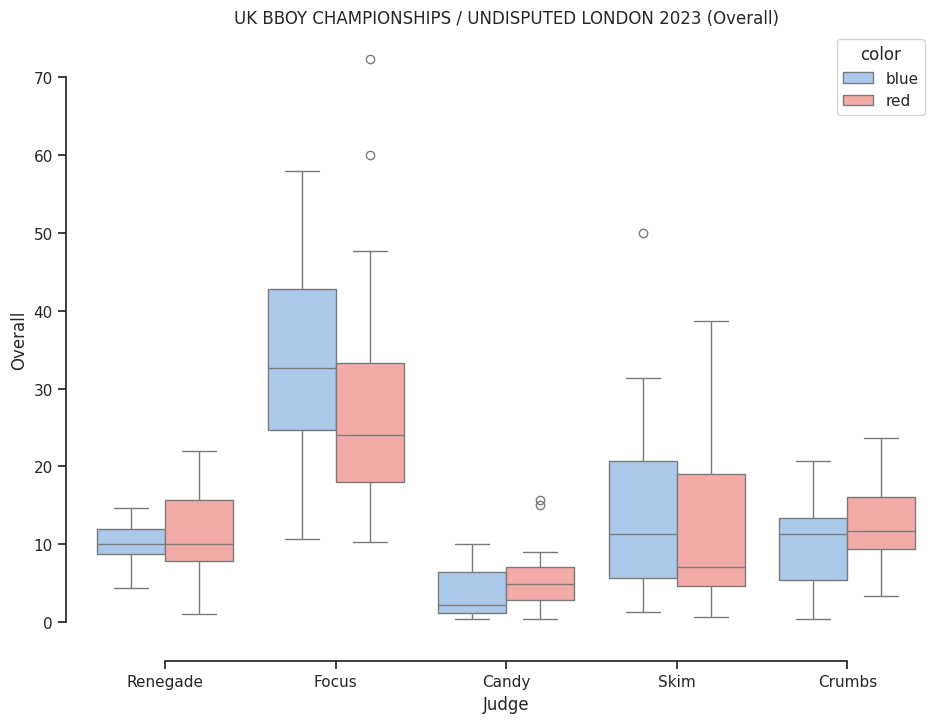

In [373]:
sns_boxplot(event25, temp_df25)

In [374]:
statistics_judges(temp_df25)


Judge :  Renegade
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count |  48       |             48       |           48       |                   48       |            0 |            0 |             0 |
| mean  |  10.5488  |              4.8475  |            4.54208 |                    2.75687 |          nan |          nan |           nan |
| std   |   4.10016 |              2.93865 |            2.4842  |                    2.63637 |          nan |          nan |           nan |
| min   |   1       |              0       |            0       |                    0       |          nan |          nan |           

# Norwegian Championships - Breaking & Hip Hop 2023

In [375]:
event26 = events_lst[26]
temp_df26 = event_df(events_lst[26], judge_df)
print("The name of event : ", temp_df26['Event'].iloc[0])
print('')

print(tabulate(temp_df26, headers='keys', tablefmt='psql'))


The name of event :  Norwegian Championships - Breaking & Hip Hop 2023

+-------+---------------------+---------------------------------------------------+---------------------------+----------+----------+----------------+----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|       | Date                | Event                                             | Category                  | Method   | Gender   | Round_Number   | Judge    | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|-------+---------------------+---------------------------------------------------+---------------------------+----------+----------+----------------+----------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+-

In [376]:
by_judge_altair(temp_df26)

alt.VConcatChart(...)

In [377]:
by_round_altair(temp_df26)

alt.VConcatChart(...)

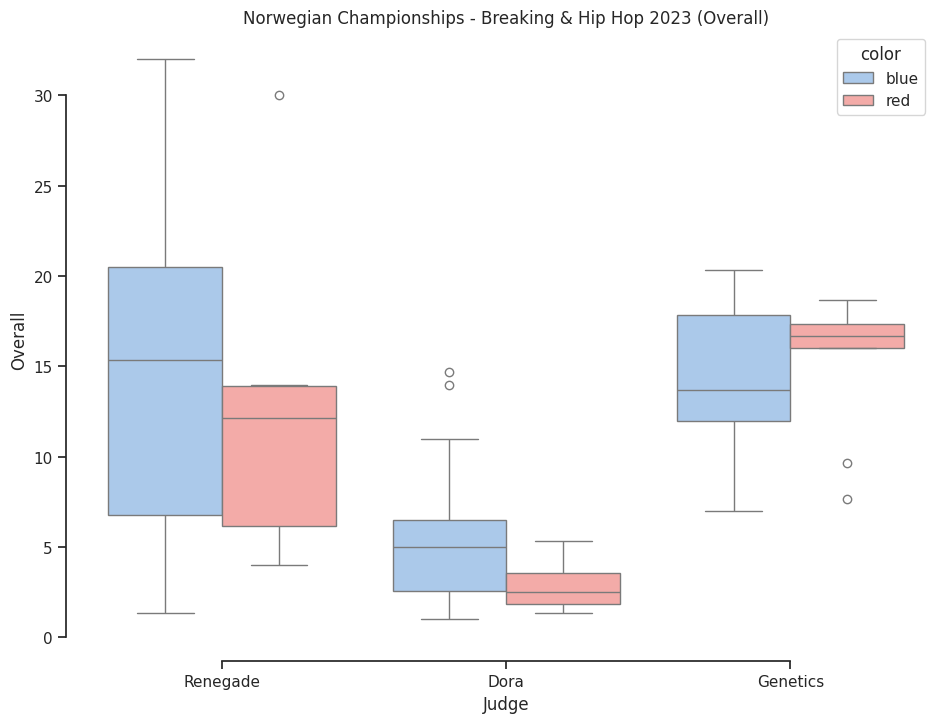

In [378]:
sns_boxplot(event26, temp_df26)

In [379]:
statistics_judges(temp_df26)


Judge :  Renegade
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count |  28       |             28       |           28       |                   28       |            0 |            0 |             0 |
| mean  |  14.5836  |              7.54821 |            5.73821 |                    5.44036 |          nan |          nan |           nan |
| std   |   9.35954 |              3.88853 |            3.13153 |                    3.89876 |          nan |          nan |           nan |
| min   |   1.33    |              0       |            0       |                    0       |          nan |          nan |           

# WDSF BfG International Series - Montreal - Canada 2023

In [380]:
event27 = events_lst[27]
temp_df27 = event_df(events_lst[27], judge_df)
print("The name of event : ", temp_df27['Event'].iloc[0])
print('')

print(tabulate(temp_df27, headers='keys', tablefmt='psql'))


The name of event :  WDSF BfG International Series - Montreal - Canada 2023

+-------+---------------------+--------------------------------------------------------+------------------------------------------+----------+----------+----------------+-------------+-------------------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+---------+
|       | Date                | Event                                                  | Category                                 | Method   | Gender   | Round_Number   | Judge       | Winner_In_Round   |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality | color   |
|-------+---------------------+--------------------------------------------------------+------------------------------------------+----------+----------+----------------+-------------+-------------------+-----------+---------------

In [381]:
by_judge_altair(temp_df27)

alt.VConcatChart(...)

In [382]:
by_round_altair(temp_df27)

alt.VConcatChart(...)

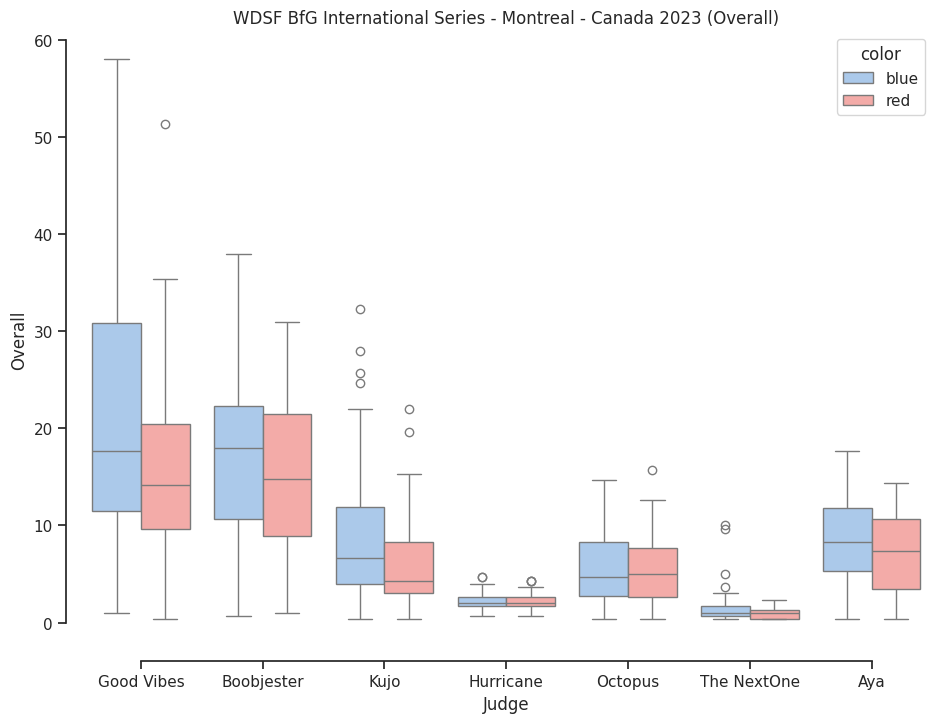

In [383]:
sns_boxplot(event27, temp_df27)

In [384]:
statistics_judges(temp_df27)


Judge :  Good Vibes
+-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------+
|       |   Overall |   Technique_Physical |   Variety_Artistic |   Performance_Interpretive |   Musicality |   Creativity |   Personality |
|-------+-----------+----------------------+--------------------+----------------------------+--------------+--------------+---------------|
| count |  141      |            141       |          141       |                  141       |            0 |            0 |             0 |
| mean  |   19.0023 |              9.79191 |            7.89872 |                    8.32844 |          nan |          nan |           nan |
| std   |   11.9333 |              4.71983 |            4.04502 |                    4.02998 |          nan |          nan |           nan |
| min   |    0.33   |              0.67    |            0       |                    0       |          nan |          nan |         

# Thank you!